# Import Modules

In [2]:
from fish_helpers import *
import anndata
import json

In [259]:
normalized_template = template-np.percentile(template.ravel(),50)
normalized_template = normalized_template/np.percentile(normalized_template.ravel(),95)
normalized_template[normalized_template<0] = 0
normalized_template[normalized_template>1] = 1
normalized_template = normalized_template*255
reference = ara_nissl[670,:,:].copy()
normalized_reference = reference-np.percentile(reference.ravel(),50)
normalized_reference = normalized_reference/np.percentile(normalized_reference.ravel(),95)
normalized_reference[normalized_reference<0] = 0
normalized_reference[normalized_reference>1] = 1
normalized_reference = normalized_reference*255

In [ ]:
fixed = sitk.GetImageFromArray(normalized_reference.astype('float32'))#sitk.ReadImage(sys.argv[1], sitk.sitkFloat32)

moving = sitk.GetImageFromArray(normalized_template.astype('float32'))#sitk.ReadImage(sys.argv[2], sitk.sitkFloat32)

  0 = 8177.19385 : (0.45429724399688326, 3.9741180171324597)
  1 = 7870.14517 : (0.4646329389027463, 7.974104663786522)
  2 = 7751.31265 : (-1.2487259365333823, 11.588575768106523)
  3 = 7775.62202 : (-1.6924582922199332, 9.638421518690118)
  4 = 7720.81543 : (-3.278282532007238, 8.419749503542885)
  5 = 7701.45440 : (-3.6381169726626292, 9.352765674527195)
  6 = 7708.75658 : (-4.070601666665693, 9.101853360255703)
  7 = 7777.49221 : (-4.471680328353257, 9.400409732049898)
  8 = 7700.25126 : (-4.5229153417687105, 9.155716100338081)
  9 = 7730.88692 : (-4.587275957223018, 9.262873513419692)
 10 = 7718.63388 : (-4.599184268724323, 9.201518463772675)
 11 = 7726.46029 : (-4.6298350399809625, 9.207608843183943)
 12 = 7727.29953 : (-4.632095254348375, 9.1921481816194)
-------
itk::simple::Transform
 TranslationTransform (0x55ef2b3816c0)
   RTTI typeinfo:   itk::TranslationTransform<double, 2u>
   Reference Count: 2
   Modified Time: 778937
   Debug: Off
   Object Name: 
   Observers: 
     n

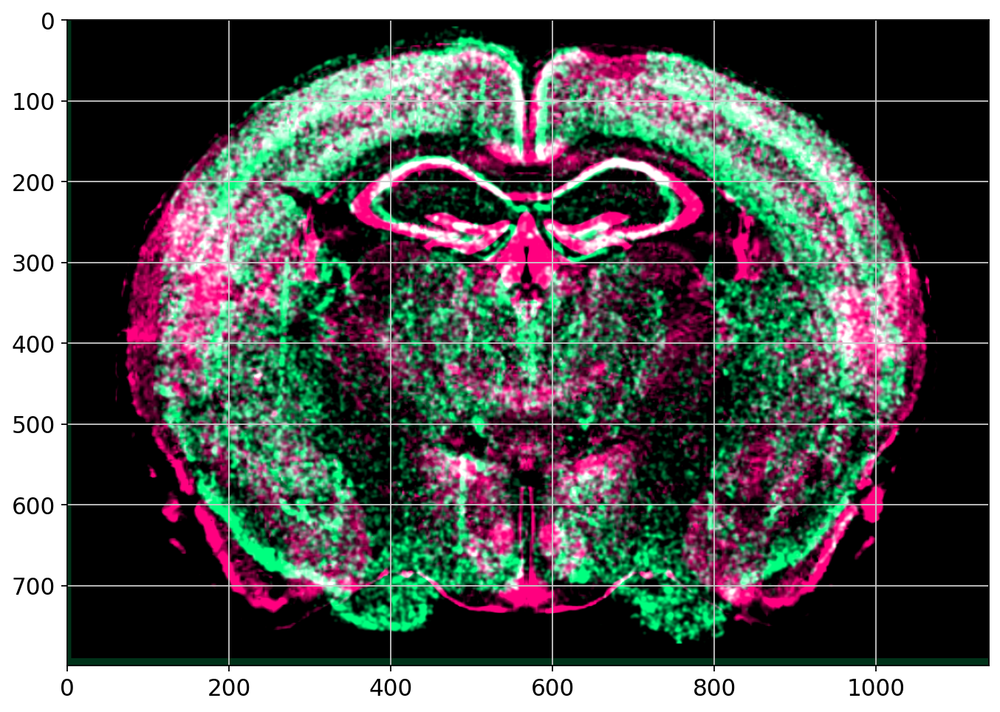

In [260]:
from __future__ import print_function

import SimpleITK as sitk
import sys
import os


def command_iteration(method) :
    print("{0:3} = {1:10.5f} : {2}".format(method.GetOptimizerIteration(),
                                   method.GetMetricValue(),
                                   method.GetOptimizerPosition()))

# if len ( sys.argv ) < 4:
#     print( "Usage: {0} <fixedImageFilter> <movingImageFile> <outputTransformFile>".format(sys.argv[0]))
#     sys.exit ( 1 )


fixed = sitk.GetImageFromArray(normalized_reference.astype('float32'))#sitk.ReadImage(sys.argv[1], sitk.sitkFloat32)

moving = sitk.GetImageFromArray(normalized_template.astype('float32'))#sitk.ReadImage(sys.argv[2], sitk.sitkFloat32)

R = sitk.ImageRegistrationMethod()
R.SetMetricAsMeanSquares()
R.SetOptimizerAsRegularStepGradientDescent(4.0, .01, 200 )
R.SetInitialTransform(sitk.TranslationTransform(fixed.GetDimension()))
R.SetInterpolator(sitk.sitkLinear)

R.AddCommand( sitk.sitkIterationEvent, lambda: command_iteration(R) )

outTx = R.Execute(fixed, moving)

print("-------")
print(outTx)
print("Optimizer stop condition: {0}".format(R.GetOptimizerStopConditionDescription()))
print(" Iteration: {0}".format(R.GetOptimizerIteration()))
print(" Metric value: {0}".format(R.GetMetricValue()))

# sitk.WriteTransform(outTx,  sys.argv[3])

if ( not "SITK_NOSHOW" in os.environ ):

    resampler = sitk.ResampleImageFilter()
    resampler.SetReferenceImage(fixed);
    resampler.SetInterpolator(sitk.sitkLinear)
    resampler.SetDefaultPixelValue(50)
    resampler.SetTransform(outTx)

    out = resampler.Execute(moving)
    simg1 = sitk.Cast(sitk.RescaleIntensity(fixed), sitk.sitkUInt8)
    simg2 = sitk.Cast(sitk.RescaleIntensity(out), sitk.sitkUInt8)
    cimg = sitk.Compose(simg1, simg2, simg1//2.+simg2//2.)
    # sitk.Show( cimg, "ImageRegistration1 Composition" )
plt.figure(figsize=[10,10])
plt.imshow(sitk.GetArrayFromImage(cimg))
plt.show()

Initial Parameters:
(0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

LBFGSBOptimizerv4 (0x55ef2b540ac0): LBFGSB optimizer does not support scaling. All scales are set to one.



  0 =   -0.13550
  0 =   -0.13721
  0 =   -0.14292
  0 =   -0.16141
  0 =   -0.16141
  1 =   -0.16509
  1 =   -0.16509
  2 =   -0.18769
  2 =   -0.18769
  3 =   -0.16934
  3 =   -0.19924
  3 =   -0.19924
  4 =   -0.20817
  4 =   -0.20817
  5 =   -0.21884
  5 =   -0.21884
  6 =   -0.23038
  6 =   -0.23038
  7 =   -0.24381
  7 =   -0.24381
  8 =   -0.26408
  8 =   -0.26408
  9 =   -0.23953
  9 =   -0.26683
  9 =   -0.26683
 10 =   -0.27169
 10 =   -0.27169
 11 =   -0.27701
 11 =   -0.27701
 12 =   -0.28349
 12 =   -0.28349
 13 =   -0.28863
 13 =   -0.28863
 14 =   -0.29561
 14 =   -0.29561
 15 =   -0.30182
 15 =   -0.30182
 16 =   -0.30495
 16 =   -0.30495
 17 =   -0.30849
 17 =   -0.30849
 18 =   -0.31176
 18 =   -0.31176
 19 =   -0.31424
 19 =   -0.31424
-------
itk::simple::Transform
 BSplineTransform (0x55ef380f1450)
   RTTI typeinfo:   itk::BSplineTransform<double, 2u, 3u>
   Reference Count: 3
   Modified Time: 779791
   Debug: Off
   Object Name: 
   Observers: 
     none
   Coeff

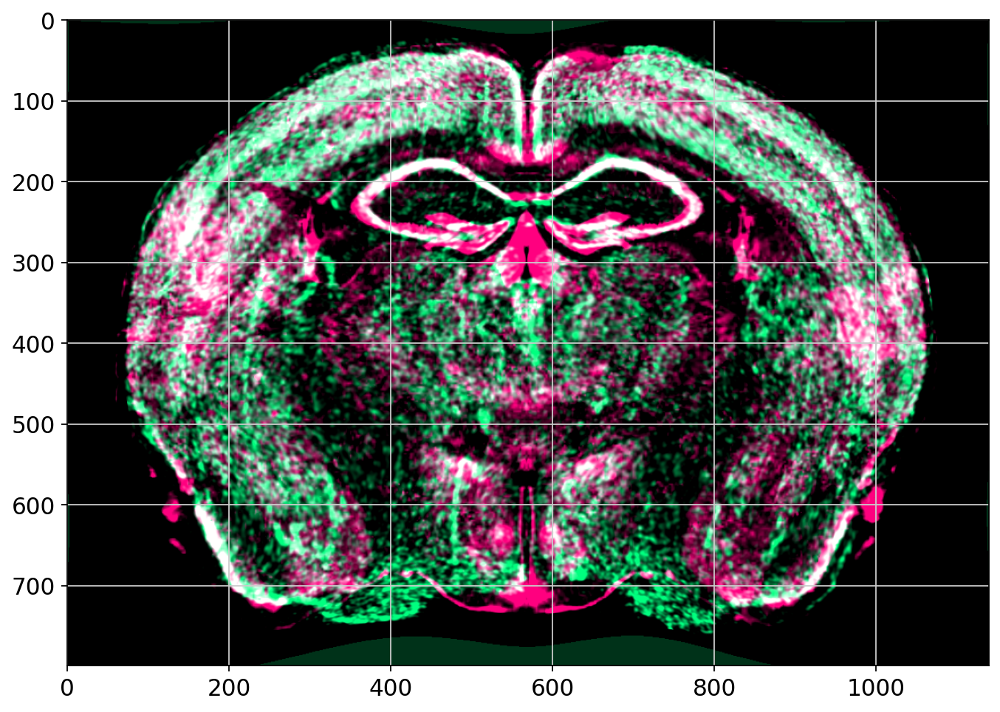

In [261]:
from __future__ import print_function

import SimpleITK as sitk
import sys
import os


def command_iteration(method) :
    print("{0:3} = {1:10.5f}".format(method.GetOptimizerIteration(),
                                     method.GetMetricValue()))

# if len ( sys.argv ) < 4:
#     print( "Usage: {0} <fixedImageFilter> <movingImageFile> <outputTransformFile>".format(sys.argv[0]))
#     sys.exit ( 1 )


# fixed = sitk.GetImageFromArray(normalized_reference.astype('float32'))#sitk.ReadImage(sys.argv[1], sitk.sitkFloat32)

# moving = sitk.GetImageFromArray(normalized_template.astype('float32'))#sitk.ReadImage(sys.argv[2], sitk.sitkFloat32)

transformDomainMeshSize=[8]*moving.GetDimension()
tx = sitk.BSplineTransformInitializer(fixed,
                                      transformDomainMeshSize )

print("Initial Parameters:");
print(tx.GetParameters())

R = sitk.ImageRegistrationMethod()
R.SetMetricAsCorrelation()

R.SetOptimizerAsLBFGSB(gradientConvergenceTolerance=1e-4,
                       numberOfIterations=100,
                       maximumNumberOfCorrections=5,
                       maximumNumberOfFunctionEvaluations=1000,
                       costFunctionConvergenceFactor=1e+6)
R.SetInitialTransform(tx, True)
R.SetInterpolator(sitk.sitkLinear)

R.AddCommand( sitk.sitkIterationEvent, lambda: command_iteration(R) )

outTx = R.Execute(fixed, moving)

print("-------")
print(outTx)
print("Optimizer stop condition: {0}".format(R.GetOptimizerStopConditionDescription()))
print(" Iteration: {0}".format(R.GetOptimizerIteration()))
print(" Metric value: {0}".format(R.GetMetricValue()))

# sitk.WriteTransform(outTx,  sys.argv[3])

if ( not "SITK_NOSHOW" in os.environ ):

    resampler = sitk.ResampleImageFilter()
    resampler.SetReferenceImage(fixed);
    resampler.SetInterpolator(sitk.sitkLinear)
    resampler.SetDefaultPixelValue(50)
    resampler.SetTransform(outTx)

    out = resampler.Execute(moving)
    simg1 = sitk.Cast(sitk.RescaleIntensity(fixed), sitk.sitkUInt8)
    simg2 = sitk.Cast(sitk.RescaleIntensity(out), sitk.sitkUInt8)
    cimg = sitk.Compose(simg1, simg2, simg1//2.+simg2//2.)
    # sitk.Show( cimg, "ImageRegistration1 Composition" )
plt.figure(figsize=[10,10])
plt.imshow(sitk.GetArrayFromImage(cimg))
plt.show()

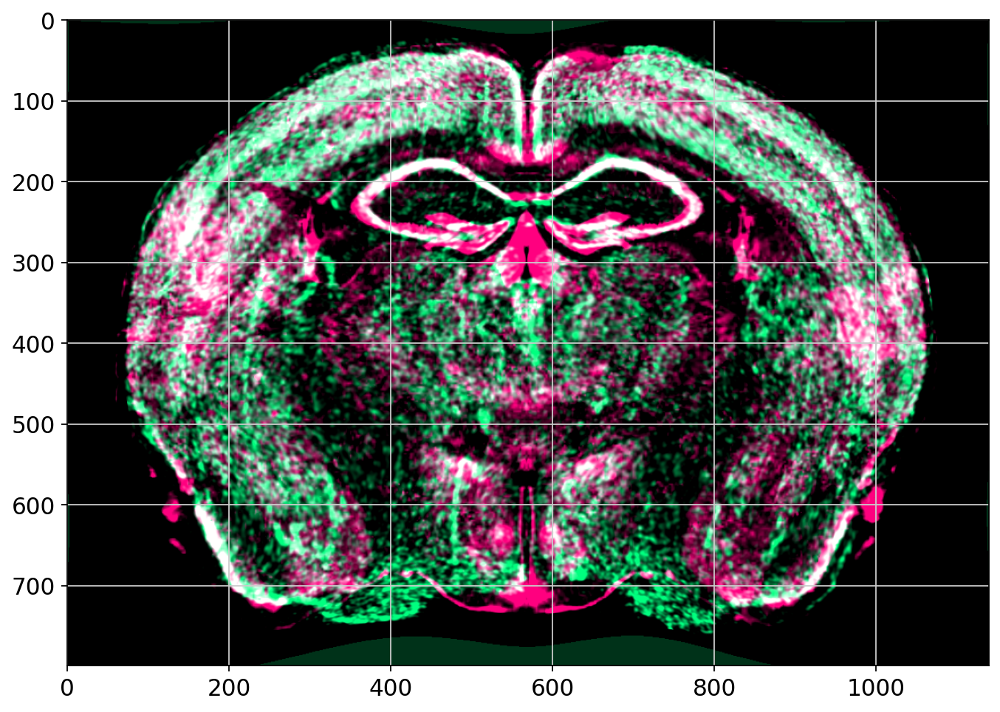

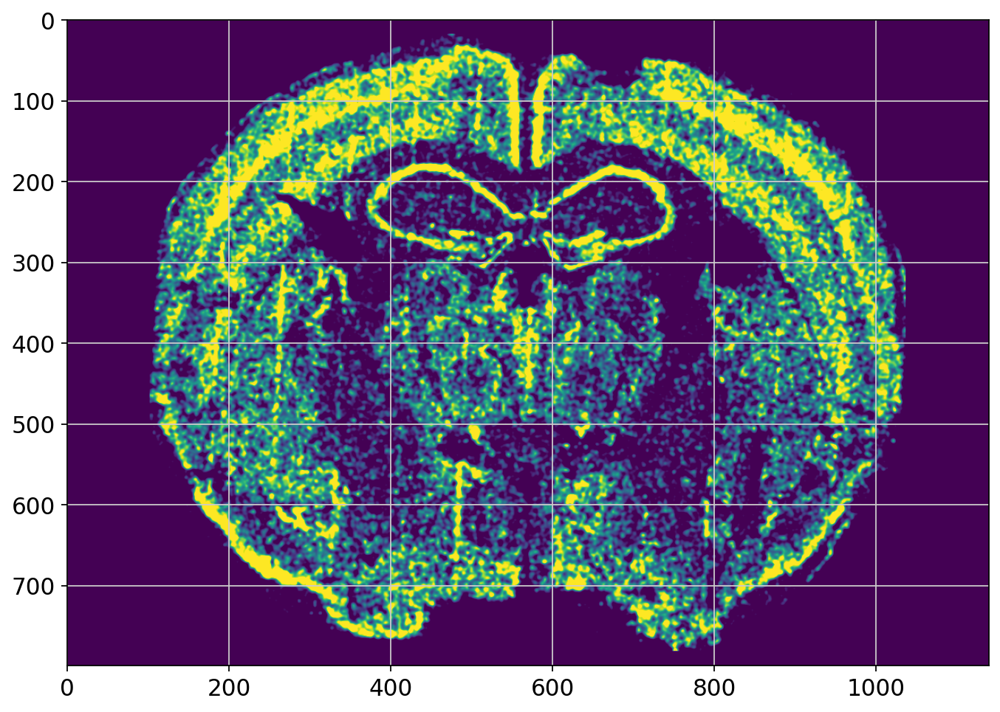

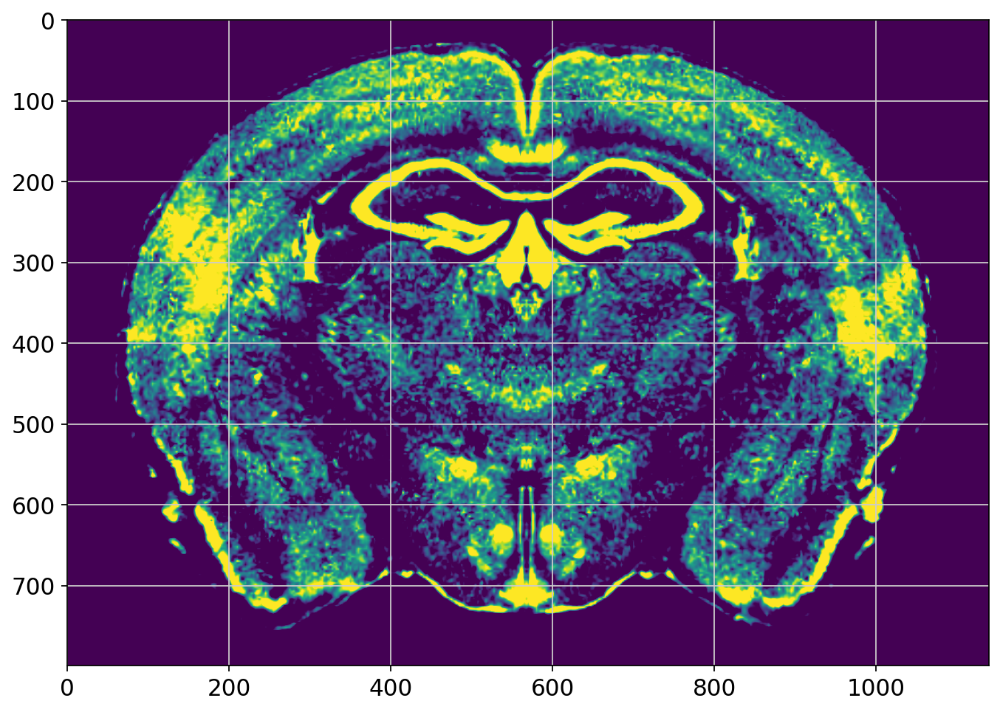

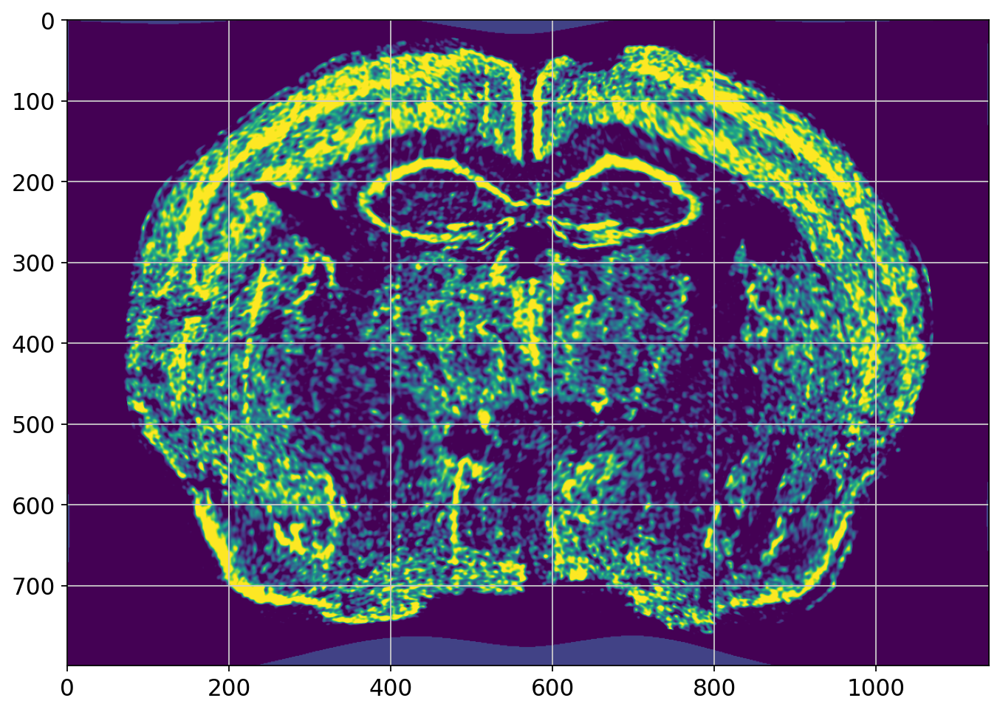

In [262]:
plt.figure(figsize=[10,10])
plt.imshow(sitk.GetArrayFromImage(cimg))
plt.show()
plt.figure(figsize=[10,10])
plt.imshow(sitk.GetArrayFromImage(moving))
plt.show()
plt.figure(figsize=[10,10])
plt.imshow(sitk.GetArrayFromImage(simg1))
plt.show()
plt.figure(figsize=[10,10])
plt.imshow(sitk.GetArrayFromImage(simg2))
plt.show()

# Load Reference

In [3]:
import json
with open('/bigstore/binfo/mouse/Brain/Allen_Spatial_Regions.json', 'r') as outfile:
    tree_dict = json.load(outfile)
ara_nissl = np.load('/bigstore/binfo/mouse/Brain/ara_nissl.npy')
annotation = np.load('/bigstore/binfo/mouse/Brain/annotations.npy')
average_template = np.load('/bigstore/binfo/mouse/Brain/average_template.npy')

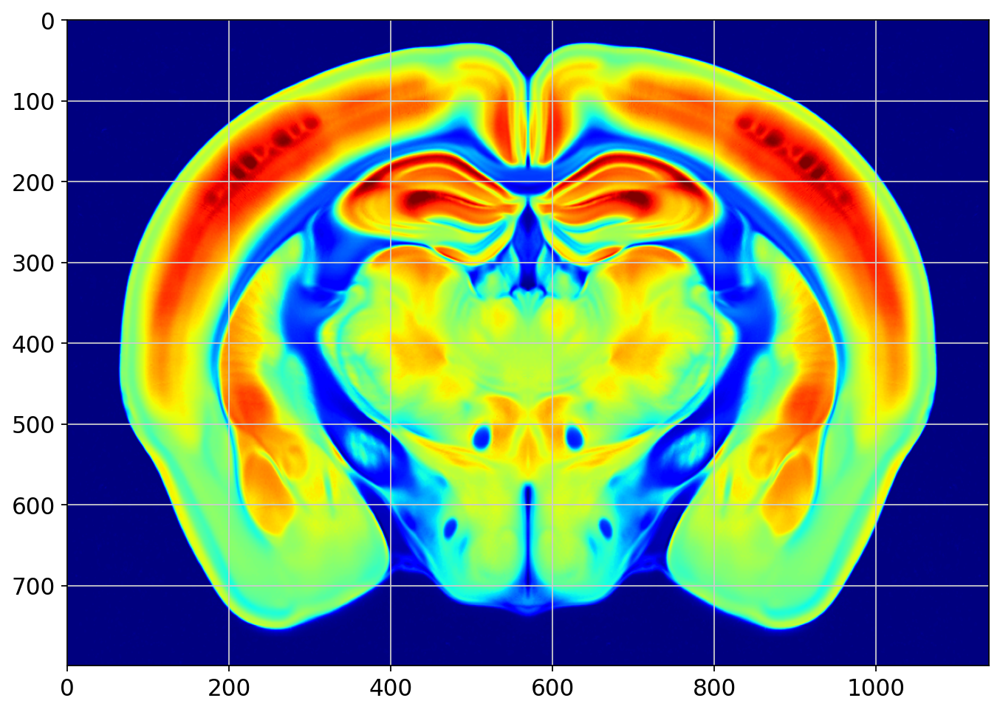

In [233]:
Display(average_template[670,:,:],cmap='jet')

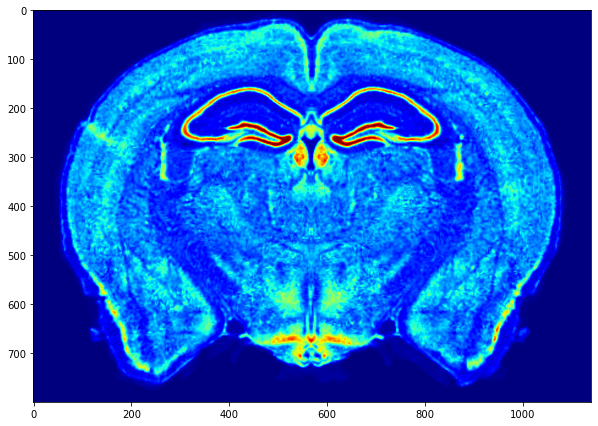

In [4]:
Display(ara_nissl[700,:,:],cmap='jet')

# Load Data

In [5]:
data = anndata.read_h5ad('/bigstore/Images2021/gaby/dredFISH/DPNMF_PolyA_2021Nov19/results/labeled.h5ad')
data

AnnData object with n_obs × n_vars = 97786 × 24
    obs: 'label', 'pixel_x', 'pixel_y', 'nuclei_size', 'nuclei_signal', 'cytoplasm_size', 'cytoplasm_signal', 'total_size', 'total_signal', 'posname', 'posname_stage_x', 'posname_stage_y', 'stage_x', 'stage_y', 'leiden', 'opt_types', 'Level_1_class_label_predicted', 'Level_2_neighborhood_label_predicted', 'Level_3_subclass_label_predicted', 'Level_4_supertype_label_predicted', 'Level_5_cluster_label_predicted'
    uns: 'leiden', 'neighbors'
    obsm: 'Level_1_class_label_predicted', 'Level_2_neighborhood_label_predicted', 'Level_3_subclass_label_predicted', 'Level_4_supertype_label_predicted', 'Level_5_cluster_label_predicted', 'stage'
    layers: 'DPNMF', 'cytoplasm_vectors', 'nuclei_vectors', 'total_vectors'
    obsp: 'connectivities', 'distances'

In [6]:
""" Add Neuronal Vs Non-Neuronal Obs"""
neuronal = ['Glutamatergic', 'GABAergic']
data.obs['Neuronal_predicted'] = False
data.obs['Neuronal_predicted'][np.isin(data.obs['Level_1_class_label_predicted'],neuronal)] = True

/tmp/ipykernel_14852/833982095.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.obs['Neuronal_predicted'][np.isin(data.obs['Level_1_class_label_predicted'],neuronal)] = True


In [7]:
neuron_data = data[data.obs['Neuronal_predicted']==True].copy()

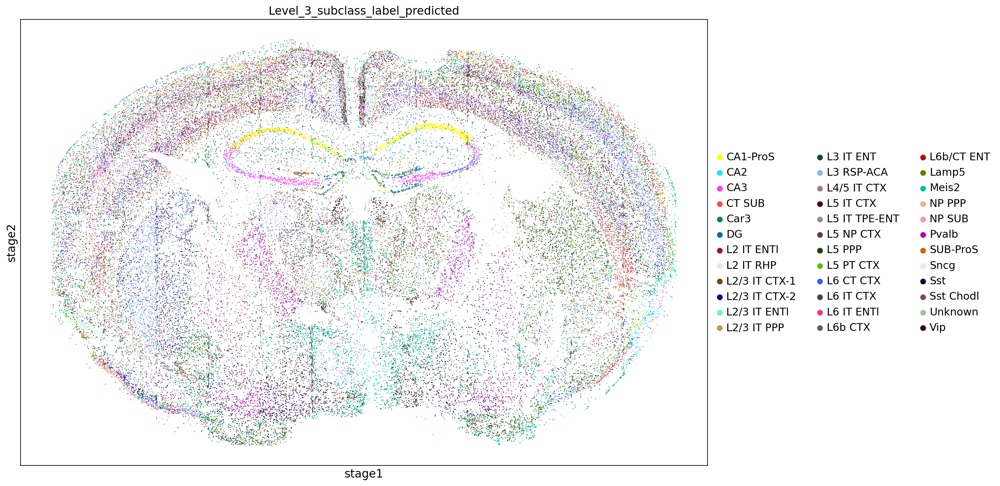

In [8]:
import scanpy as sc
sc.set_figure_params(figsize=[15,10])
sc.pl.embedding(neuron_data,'stage',color=['Level_3_subclass_label_predicted'],cmap='jet',size=5)

# Center and rotate 

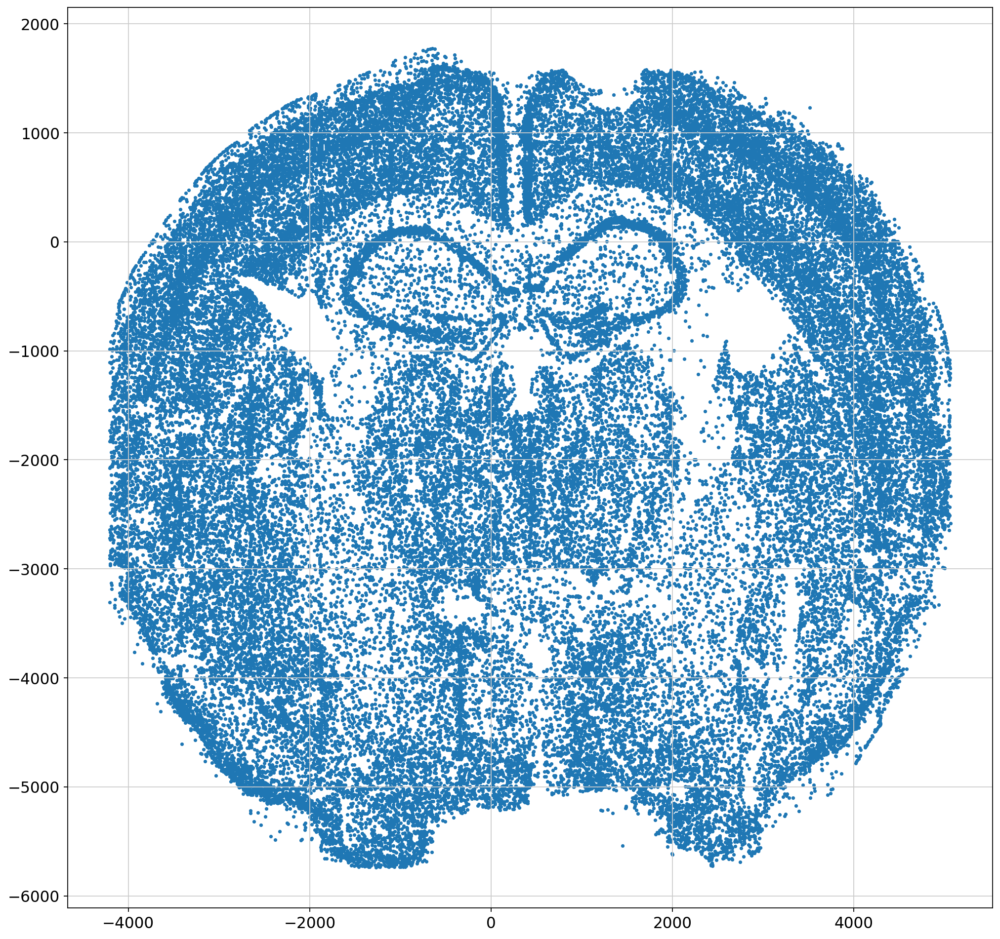

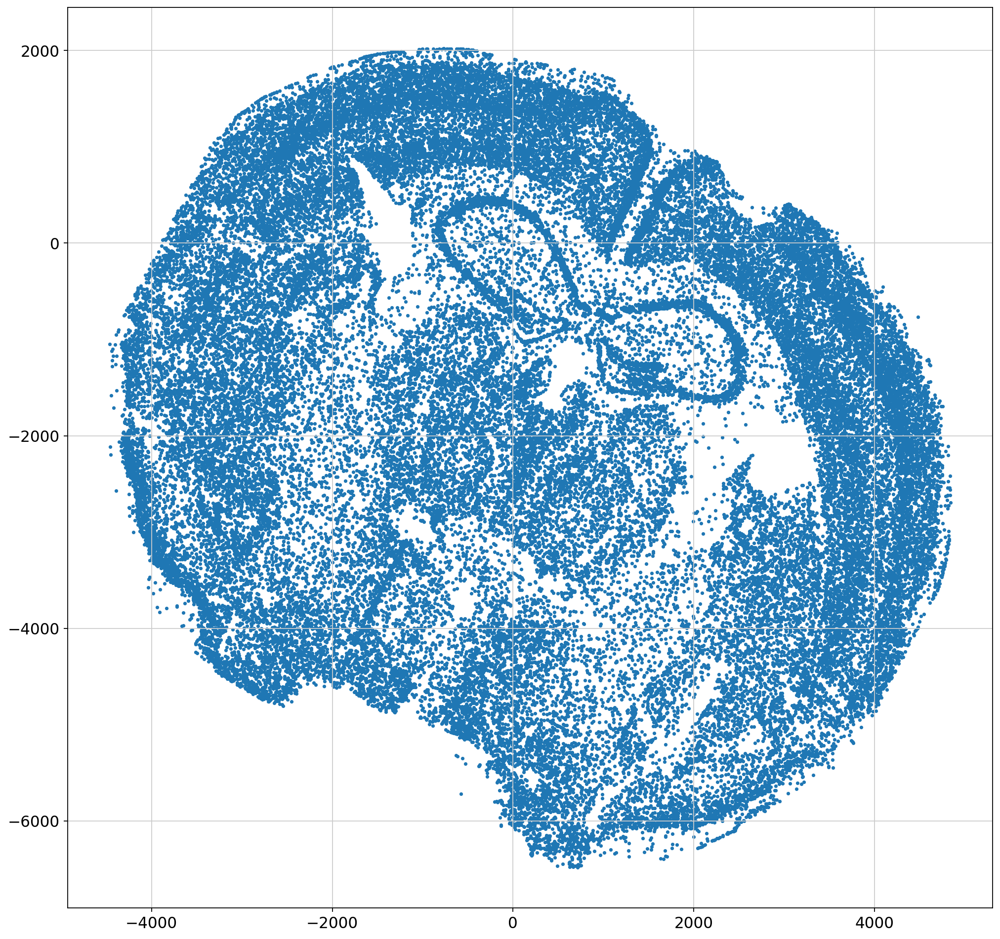

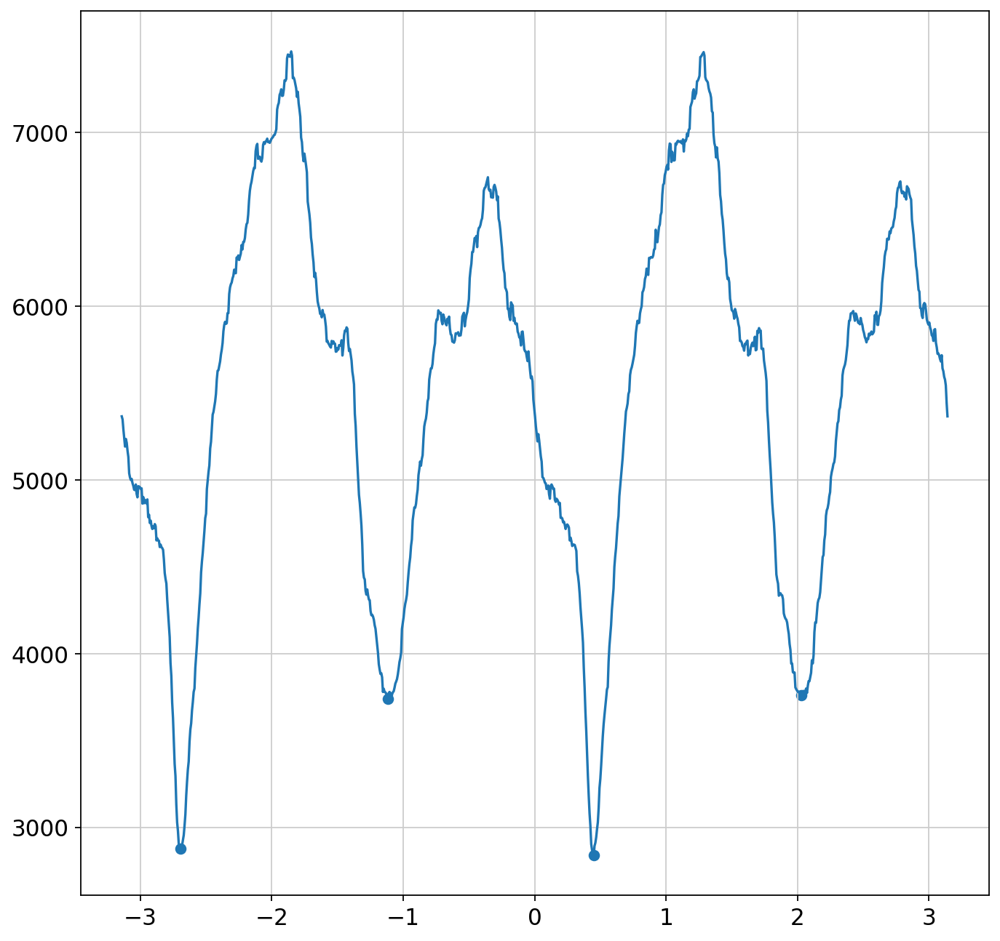

0.4497428131570218


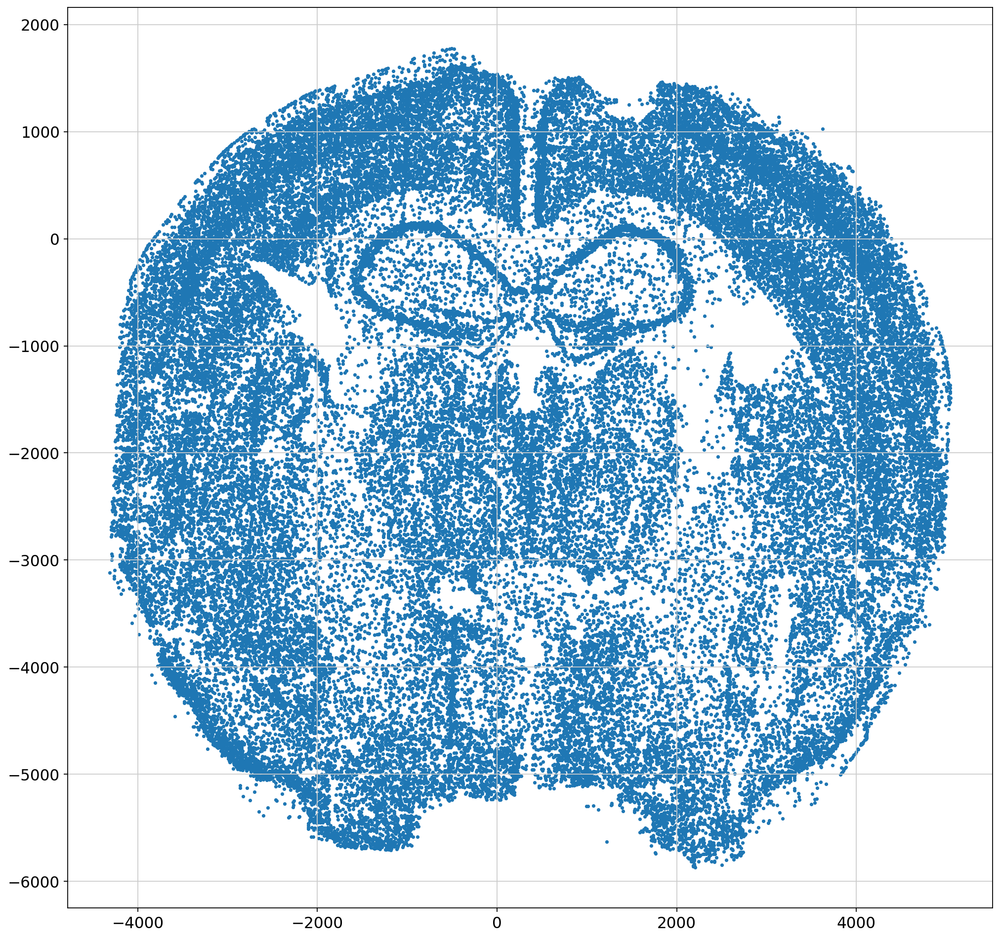

In [9]:
import math

def rotate(origin, point, angle):
    """
    Rotate a point counterclockwise by a given angle around a given origin.

    The angle should be given in radians.
    """
    ox, oy = origin
    # px, py = point
    px = point[:,0]
    py = point[:,1]

    qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
    qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
    xy = np.zeros_like(point)
    xy[:,0] = qx
    xy[:,1] = qy
    return xy

def calculate_skew(angle,xy,diameter=10,n_cells=5,p=0.01):
    xy_rotated = rotate(np.median(xy,axis=0), xy, angle)
    """ Center """
    xy_centered = xy_rotated-np.median(xy_rotated,axis=0)
    """ Calculate Skew """
    right_center = np.median(xy_centered[xy_centered[:,0]>0],axis=0)
    left_center = np.median(xy_centered[xy_centered[:,0]<0],axis=0)
    x = xy_centered[:,0]
    y = xy_centered[:,1]
    x_min = np.percentile(x,p)
    x_max = np.percentile(x,100-p)
    x_bins = int((np.abs(x_max-x_min)/diameter)/n_cells) # Distance in Cell Widths / nCells per bin
    if (x_bins % 2)==0:
        x_bins = x_bins+1
    x_bins = np.linspace(x_min,x_max,x_bins)
    y_min = np.percentile(y,p)
    y_max = np.percentile(y,100-p)
    y_bins = int((np.abs(y_max-y_min)/diameter)/n_cells) # Distance in Cell Widths / nCells per bin
    if (y_bins % 2)==0:
        y_bins = y_bins+1
    y_bins = np.linspace(y_min,y_max,y_bins)
    
    hist,x,y = np.histogram2d(y,x,bins=[y_bins,x_bins])
    hist = gaussian_filter(hist,n_cells/2)
    left = 1*(hist[:,0:int(hist.shape[1]/2)]>np.percentile(hist.ravel(),50))
    right = 1*(np.fliplr(hist[:,int(hist.shape[1]/2):])>np.percentile(hist.ravel(),50))
    skew = np.abs(right-left).sum()
    return skew
    
from functools import partial

xy = neuron_data.obsm['stage'].copy()
plt.figure(figsize=[15,15])
plt.scatter(xy[:,0],xy[:,1],s=5)
plt.show()
angle = -0.5
temp_xy = rotate(np.median(xy,axis=0),xy,angle)
pfunc = partial(calculate_skew,xy=temp_xy)
plt.figure(figsize=[15,15])
plt.scatter(temp_xy[:,0],temp_xy[:,1],s=5)
plt.show()

from scipy.optimize import fmin
n = 1000
out_array = np.zeros(n)
r = 180/57.29
a_array = np.linspace(-r,r,n)
for i,a in enumerate(a_array):
    out = pfunc(a)
    out_array[i] = out
from scipy.signal import find_peaks
""" Pick the peak with the smallest rotation """
""" Worried sometimes this may be flipped up down """
t = find_peaks(1/gaussian_filter(out_array,n/50))[0]
plt.figure(figsize=[10,10])
plt.plot(a_array,out_array)
plt.scatter(a_array[t],out_array[t])
plt.show()
top_angles = a_array[t][np.argsort(out_array[t])][0:2]
top_angle = top_angles[np.argsort(np.abs(top_angles))][0]
print(top_angle)
temp_xy = rotate(np.median(temp_xy,axis=0),temp_xy,top_angle)
plt.figure(figsize=[15,15])
plt.scatter(temp_xy[:,0],temp_xy[:,1],s=5)
plt.show()

In [10]:
centered_xy = temp_xy.copy()

# Coarse Rigid Registration XYZ

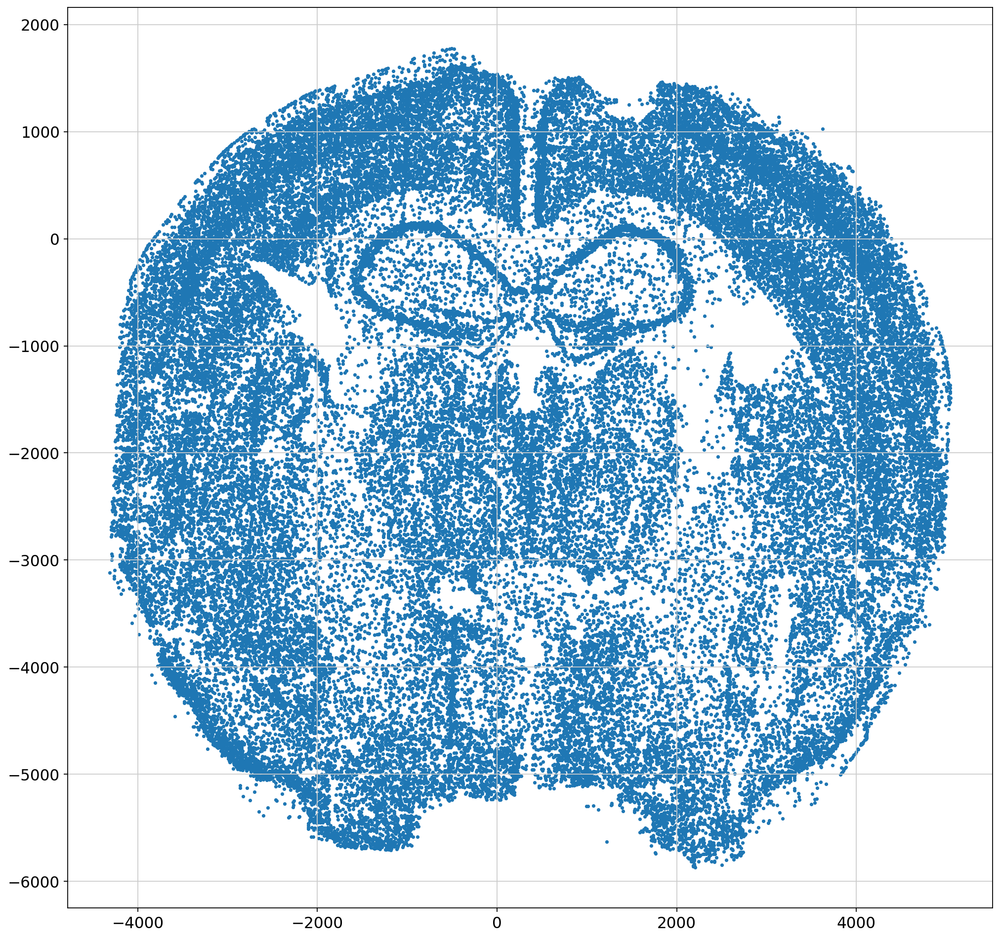

In [11]:
plt.figure(figsize=[15,15])
plt.scatter(centered_xy[:,0],centered_xy[:,1],s=5)
plt.show()

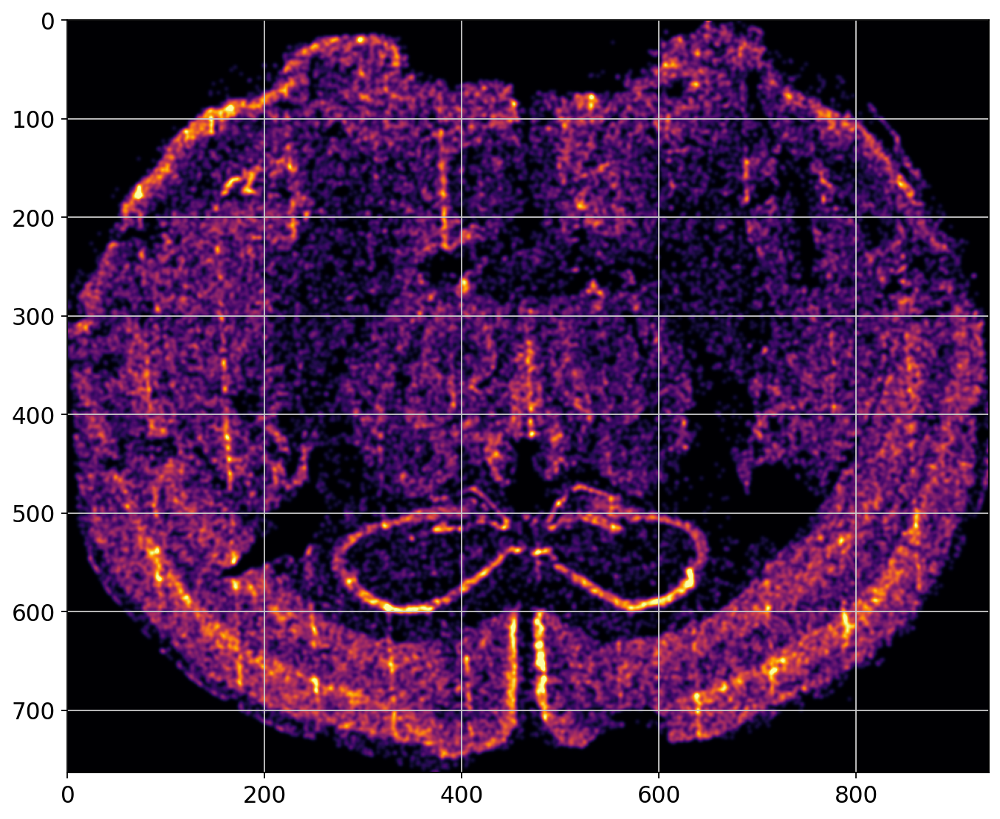

In [12]:
""" Downsample to annotation resolution """
resolution = 10 # 10 um
x = centered_xy[:,0]
y = centered_xy[:,1]
x_bins = range(int(x.min()),int(x.max()),resolution)
y_bins = range(int(y.min()),int(y.max()),resolution)
hist,y,x = np.histogram2d(y,x,bins=[y_bins,x_bins])
hist = gaussian_filter(hist,20/resolution)
Display(hist)

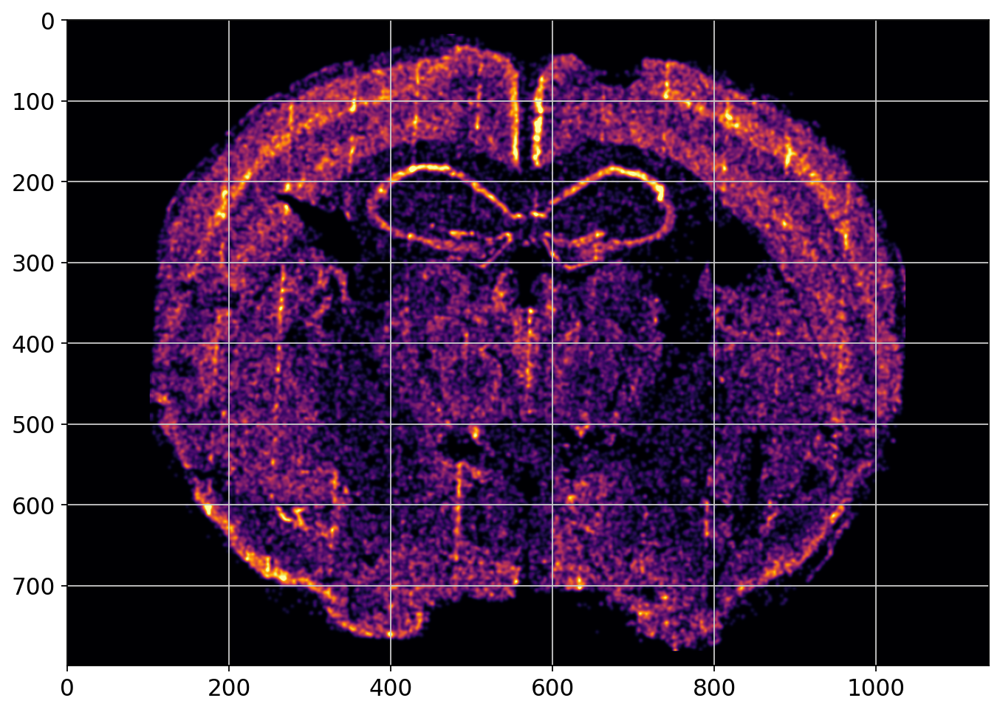

In [13]:
template = np.zeros(ara_nissl.shape[1:3])
offset = ((np.array(template.shape)-np.array(hist.shape))/2).astype(int)
t_shape = np.array(hist.shape)+offset
template[offset[0]:t_shape[0],offset[1]:t_shape[1]] = np.flipud(hist) # Fix Issue here
Display(template)

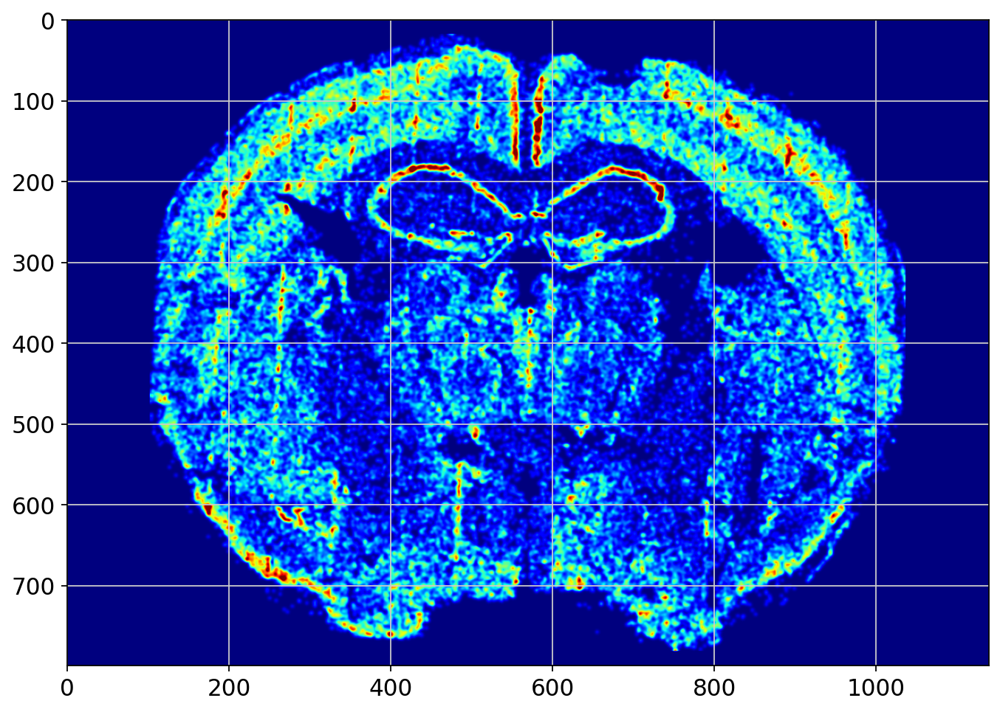

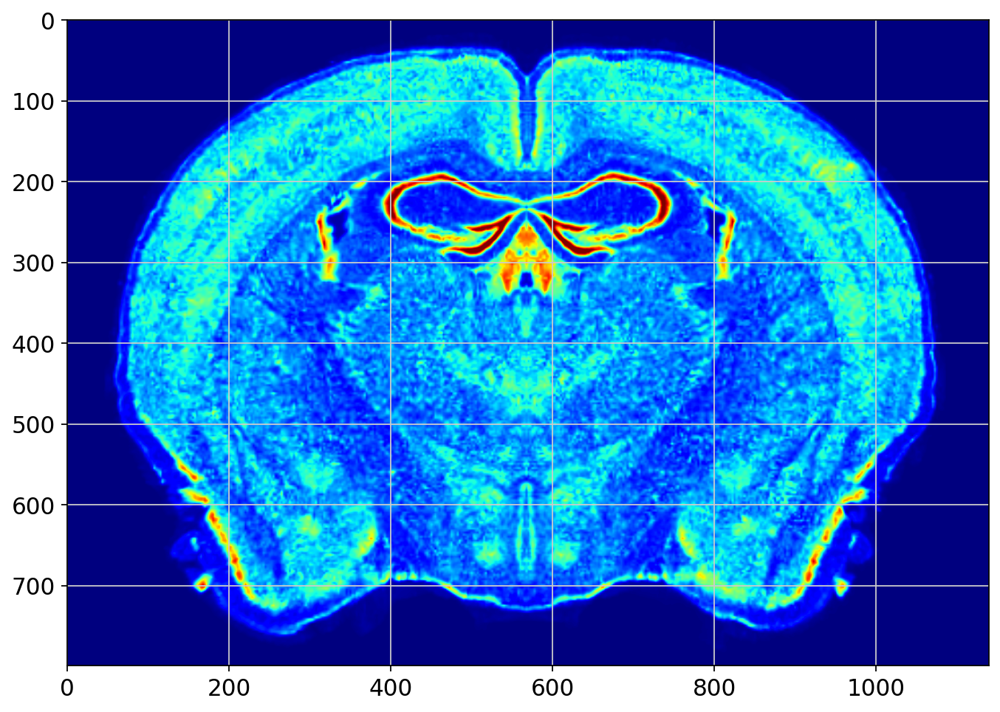

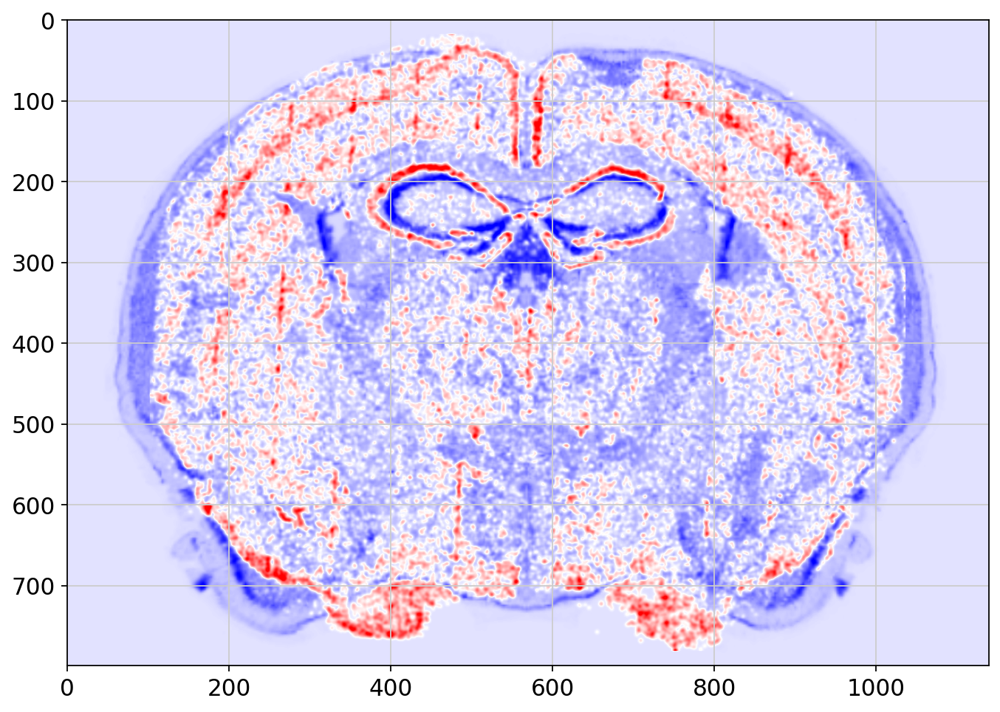

In [14]:
reference = ara_nissl[650,:,:].copy()
normalized_template = template/template.sum()
normalized_reference = reference/reference.sum()
Display(normalized_template,cmap='jet')
Display(normalized_reference,cmap='jet')
Display(normalized_template-normalized_reference,cmap='bwr')

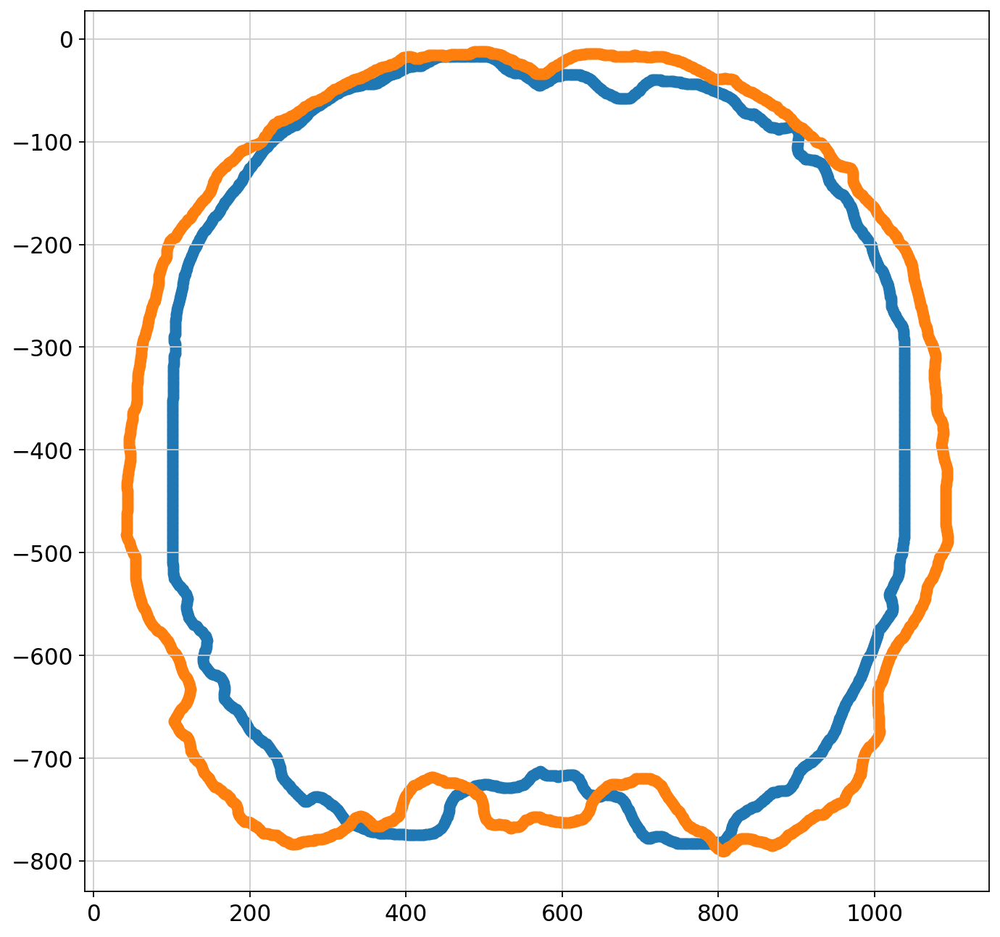

In [29]:
template_border_y,template_border_x = np.where(normalized_template_border>0)
reference_border_y,reference_border_x = np.where(normalized_reference_border>0)
plt.figure(figsize=[10,10])
plt.scatter(template_border_x,-template_border_y)
plt.scatter(reference_border_x,-reference_border_y)
plt.show()

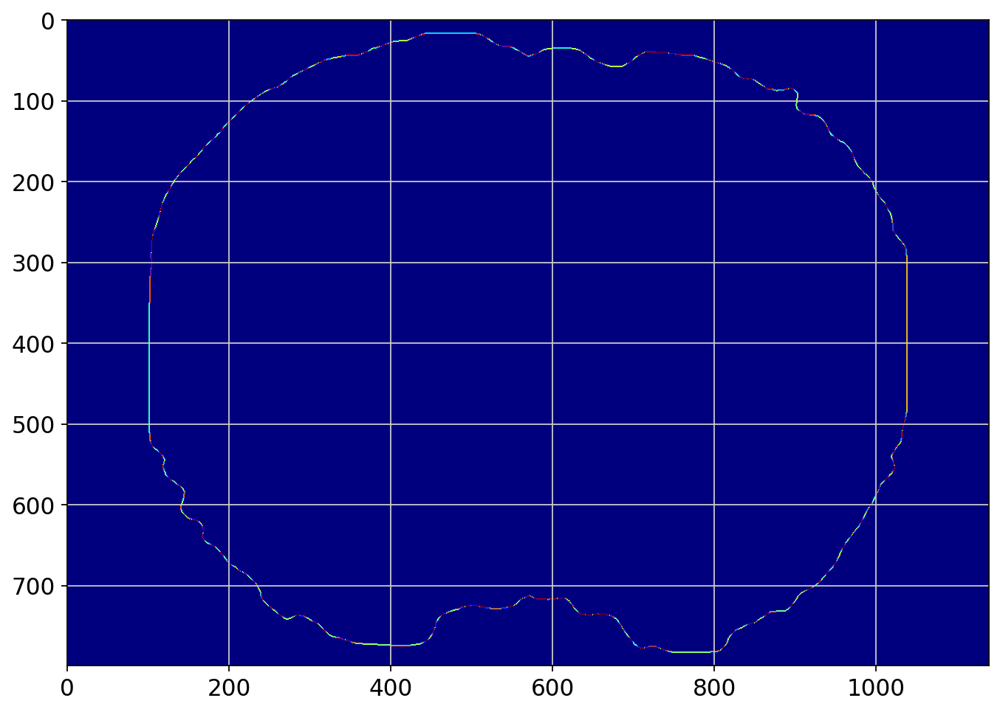

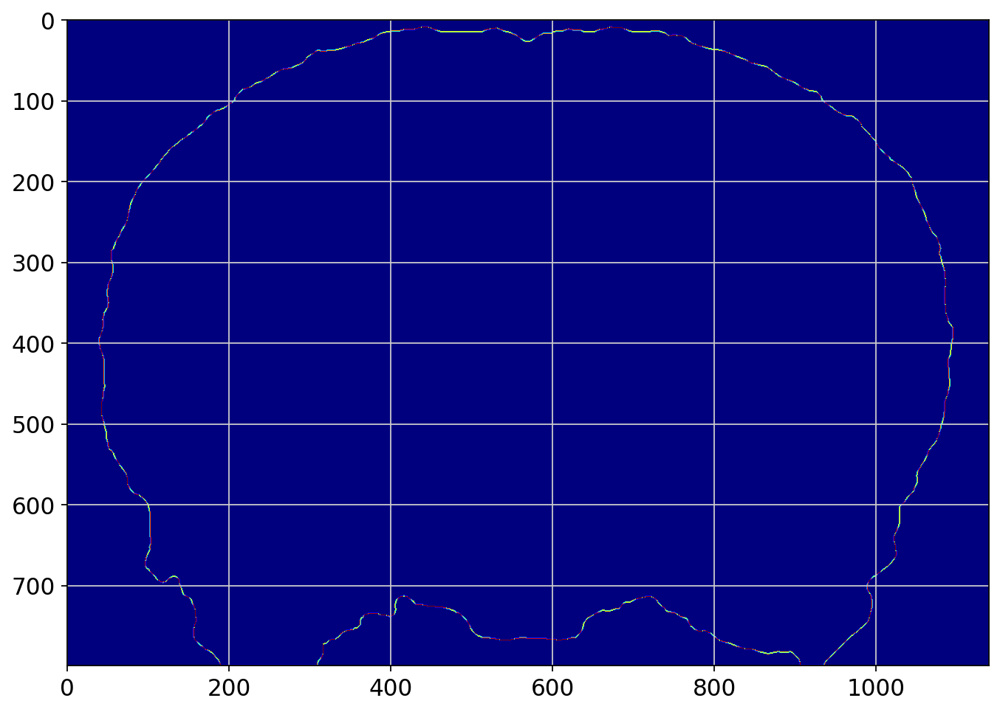

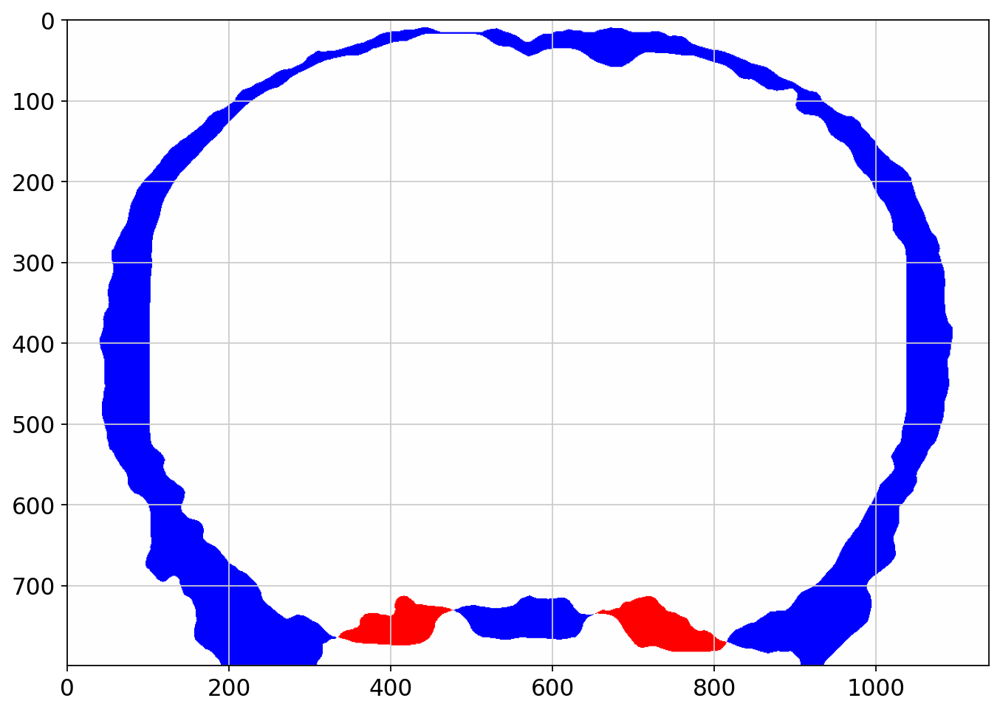

In [144]:
""" Convert to Bounding Box """
from scipy.ndimage.morphology import binary_fill_holes,binary_dilation
from scipy.ndimage import median_filter
from skimage.morphology import remove_small_objects
reference = ara_nissl[660,:,:].copy()
normalized_template = (template>0)#/template.sum()
normalized_reference = (reference>0)#/reference.sum()
normalized_template = binary_fill_holes(normalized_template)
normalized_reference = binary_fill_holes(normalized_reference)
normalized_template = remove_small_objects(normalized_template,1000)
normalized_reference = remove_small_objects(normalized_reference,1000)
normalized_template = median_filter(normalized_template,20)
normalized_reference = median_filter(normalized_reference,20)
""" Set Borders to 0 """
normalized_template[:,0] = False
normalized_template[:,-1] = False
normalized_template[0,:] = False
normalized_template[-1,:] = False

normalized_reference[:,0] = False
normalized_reference[:,-1] = False
normalized_reference[0,:] = False
normalized_reference[-1,:] = False

normalized_template_dialated = binary_dilation(normalized_template)
normalized_reference_dialated = binary_dilation(normalized_reference)
normalized_template_border = 1*normalized_template_dialated-1*normalized_template
normalized_reference_border = 1*normalized_reference_dialated-1*normalized_reference
# Display(1*normalized_template,cmap='jet')
# Display(1*normalized_reference,cmap='jet')
Display(1*normalized_template_border,cmap='jet')
Display(1*normalized_reference_border,cmap='jet')
Display(1*normalized_template-1*normalized_reference,cmap='bwr')

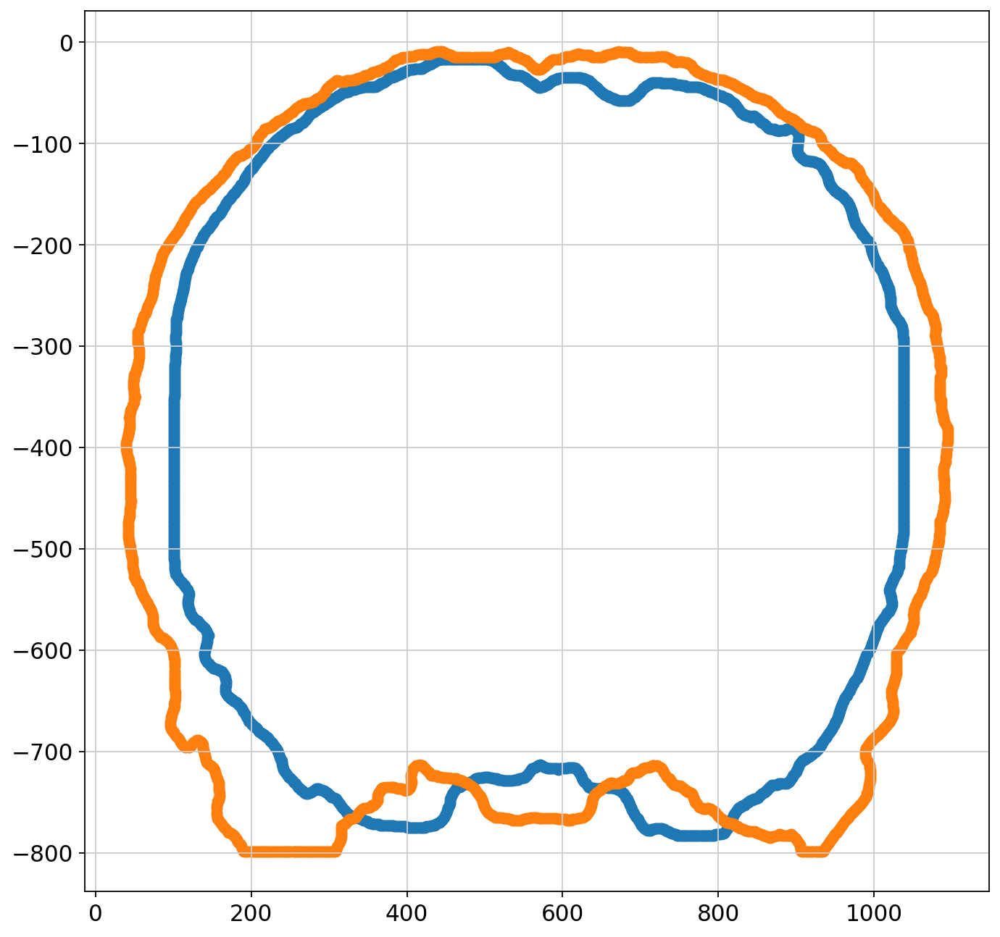

In [145]:
""" Convert to coordinates """
template_border_y,template_border_x = np.where(normalized_template_border>0)
reference_border_y,reference_border_x = np.where(normalized_reference_border>0)
""" Downsample to same number of points """
n_points = np.min([template_border_x.shape[0],reference_border_x.shape[0]])
template_idx = np.random.choice(np.array(range(template_border_x.shape[0])),n_points,replace=False)
reference_idx = np.random.choice(np.array(range(reference_border_x.shape[0])),n_points,replace=False)
template_border_x = template_border_x[template_idx]
template_border_y = template_border_y[template_idx]
reference_border_x = reference_border_x[reference_idx]
reference_border_y = reference_border_y[reference_idx]
""" Create Path starting at center"""


plt.figure(figsize=[10,10])
plt.scatter(template_border_x,-template_border_y)
plt.scatter(reference_border_x,-reference_border_y)
plt.show()

In [153]:
""" Find Starting Point """
""" Center""" 
template_x_start = int(reference.shape[1]/2)
while not np.sum(template_x_start==template_border_x)==2:
    template_x_start = template_x_start+1
template_y_start = template_border_y[template_border_x==template_x_start].min() # Choosing either top or bottom
template_idx = np.where((template_border_x==template_x_start)&(template_border_y==template_y_start))[0][0]
reference_x_start = int(reference.shape[1]/2)
while not np.sum(reference_x_start==reference_border_x)==2:
    reference_x_start = reference_x_start+1
reference_y_start = reference_border_y[reference_border_x==reference_x_start].min() # Choosing either top or bottom
reference_idx = np.where((reference_border_x==reference_x_start)&(reference_border_y==reference_y_start))[0][0]
print(template_idx,reference_idx)
print(reference_x_start,reference_y_start)
print(template_x_start,template_y_start)

984 1005
570 27
570 45


In [147]:
# """ Find Starting Point """
# """ Right"""
# template_y_start = np.max(template_border_x)
# template_idx = np.where(template_border_x==np.max(template_border_x))[0][0]
# template_y_start = template_border_y[template_idx]

# reference_x_start = np.max(reference_border_x)
# reference_idx = np.where(reference_border_x==np.max(reference_border_x))[0][0]
# reference_y_start = reference_border_y[reference_idx]

# print(template_idx,reference_idx)
# print(reference_x_start,reference_y_start)
# print(template_x_start,template_y_start)

1 2
1095 382
570 444


In [154]:
reference_xy = np.zeros([reference_border_x.shape[0],2])
reference_xy[:,0] = reference_border_x
reference_xy[:,1] = reference_border_y
template_xy = np.zeros([template_border_x.shape[0],2])
template_xy[:,0] = template_border_x
template_xy[:,1] = template_border_y

In [155]:
import torch
import time
def order_points(xy,start_idx=0):
    dist_mat = torch.cdist(torch.tensor(xy),torch.tensor(xy))
    total_idxes = np.array(range(dist_mat.shape[0]))
    used_idxes = []
    while len(used_idxes)!=total_idxes.shape[0]:
        if len(used_idxes)==0:
            idx = start_idx
        used_idxes.append(idx)
        remaining_idxes = total_idxes[np.isin(total_idxes,used_idxes)==False]
        if remaining_idxes.shape[0]>0:
            temp_idx = torch.argmin(dist_mat[idx,remaining_idxes])
            idx = remaining_idxes[temp_idx]
        xy_ordered = xy[used_idxes,:]
    return xy_ordered
start=time.time()
reference_ordered_xy = order_points(reference_xy,start_idx=reference_idx)
print(time.time()-start)
start=time.time()
template_ordered_xy = order_points(template_xy,start_idx=template_idx)
print(time.time()-start)


2.0178489685058594
1.9950249195098877


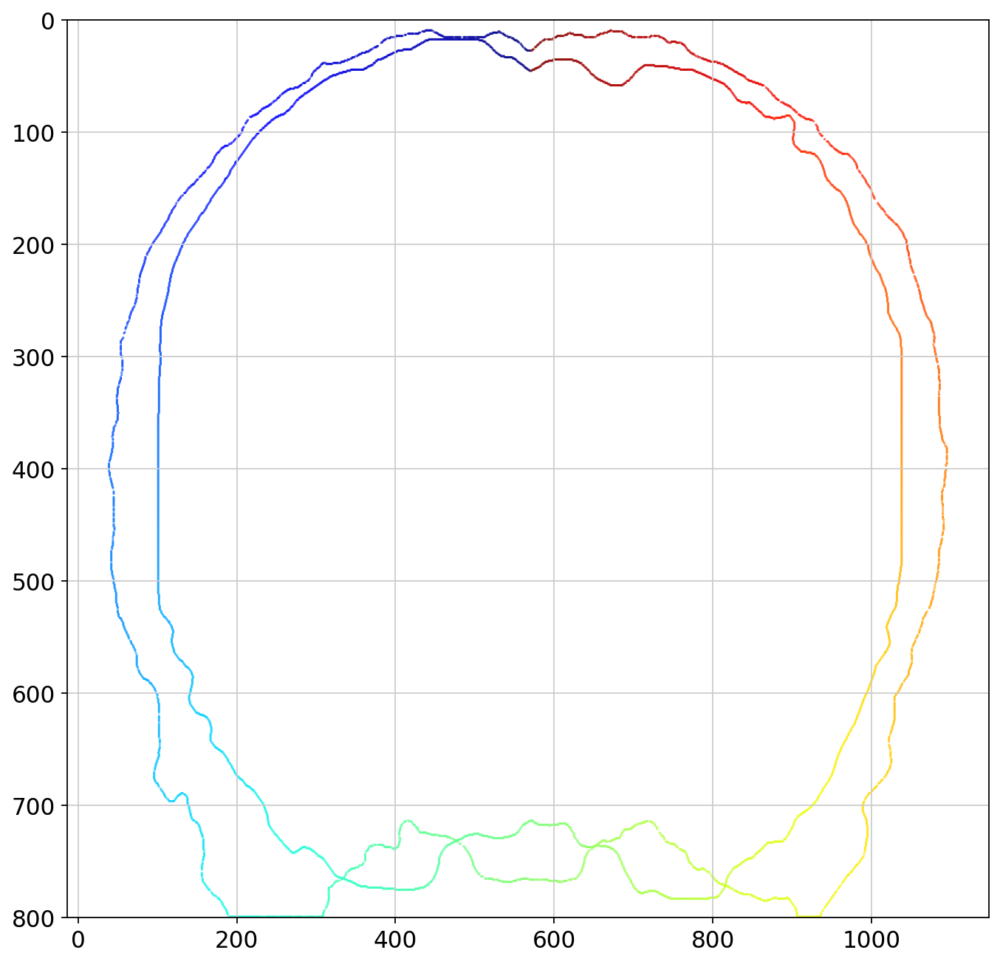

(210906.0, 1779544.0)

In [176]:
""" Make sure order is in the same direction """
forward_error = np.abs(template_ordered_xy-reference_ordered_xy).sum()
reverse_error = np.abs(template_ordered_xy-np.flipud(reference_ordered_xy)).sum()
if forward_error>reverse_error:
    reference_ordered_xy = np.flipud(reference_ordered_xy)
plt.figure(figsize=[10,10])
xy = template_ordered_xy
plt.scatter(xy[:,0],xy[:,1],c=np.array(range(xy.shape[0])),cmap='jet',s=0.1)
xy = reference_ordered_xy
plt.scatter(xy[:,0],xy[:,1],c=np.array(range(xy.shape[0])),cmap='jet',s=0.1)
plt.ylim([800,0])
plt.show()
np.abs(template_ordered_xy-reference_ordered_xy).sum(),np.abs(template_ordered_xy-np.flipud(reference_ordered_xy)).sum()


In [173]:
import cv2
normalized_template = template-np.percentile(template.ravel(),50)
normalized_template = normalized_template/np.percentile(normalized_template.ravel(),95)
normalized_template[normalized_template<0] = 0
normalized_template[normalized_template>1] = 1
normalized_template = normalized_template*255

normalized_reference = reference-np.percentile(reference.ravel(),50)
normalized_reference = normalized_reference/np.percentile(normalized_reference.ravel(),95)
normalized_reference[normalized_reference<0] = 0
normalized_reference[normalized_reference>1] = 1
normalized_reference = normalized_reference*255

p1 = template_ordered_xy
p2 = reference_ordered_xy
homography, mask = cv2.findHomography(p1, p2)#, cv2.RANSAC)
 
# Use this matrix to transform the
# colored image wrt the reference image.
transformed_img = cv2.warpPerspective(img1,
                    homography, (img1.shape[1],img1.shape[0]))

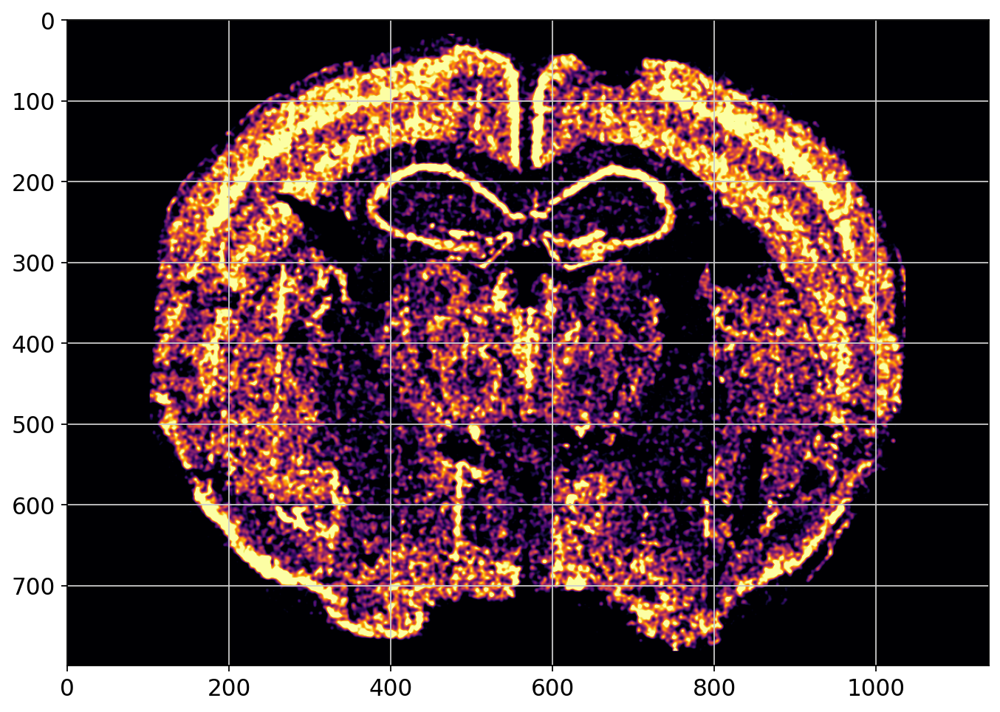

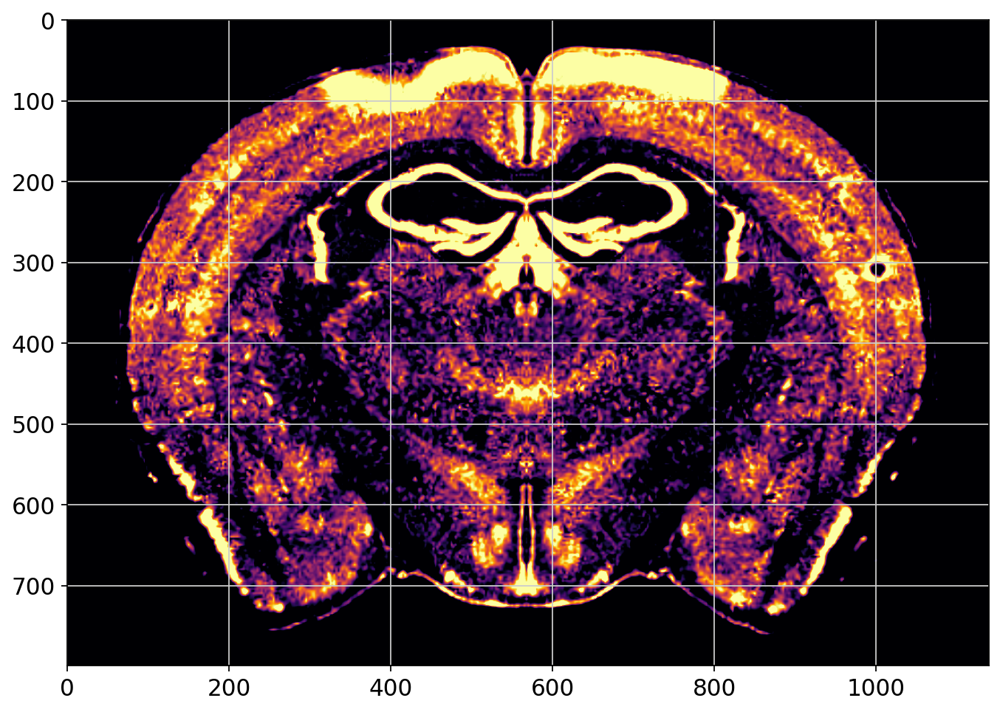

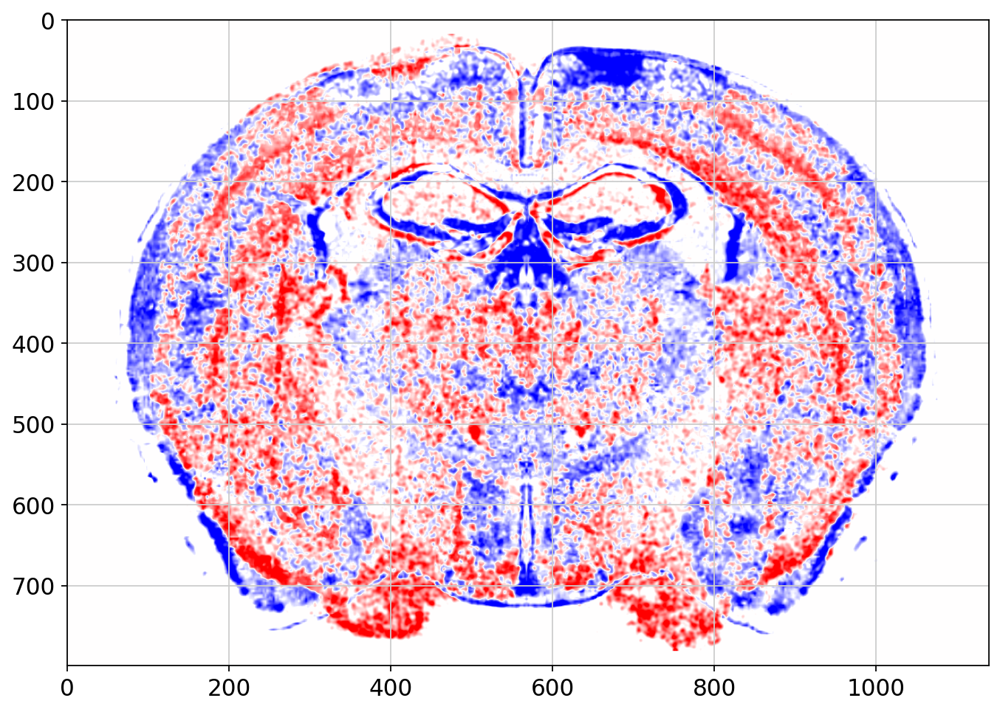

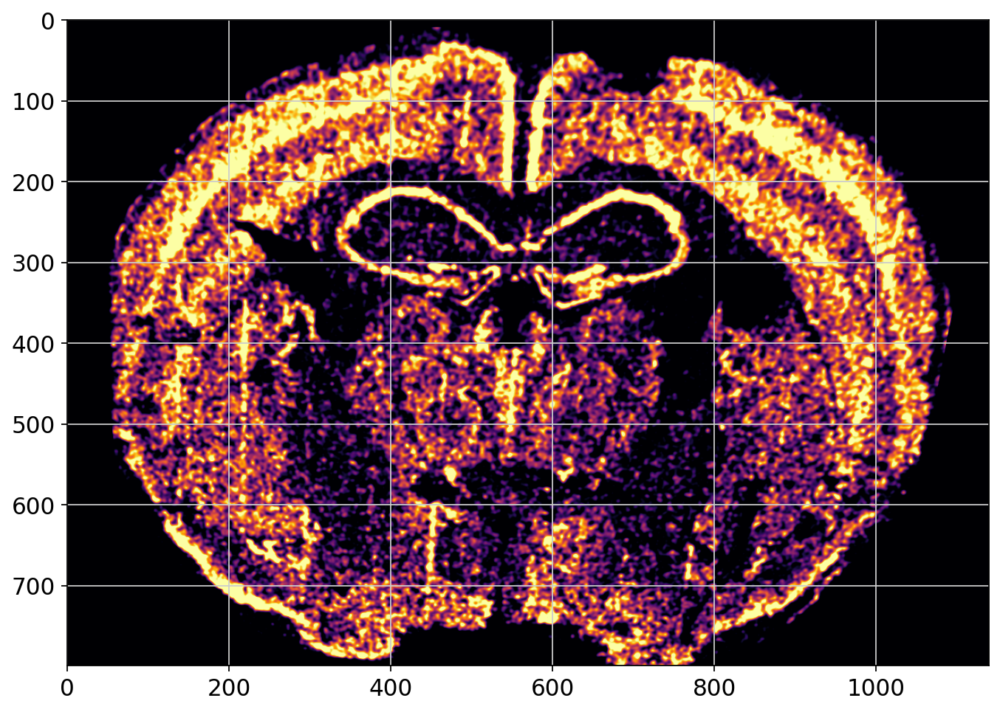

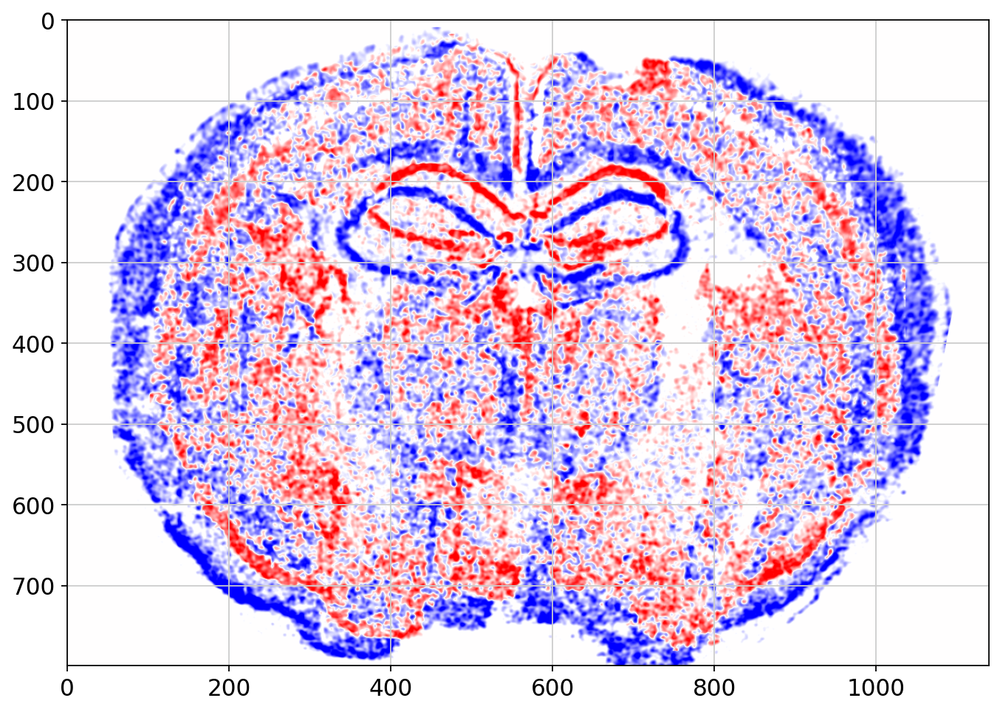

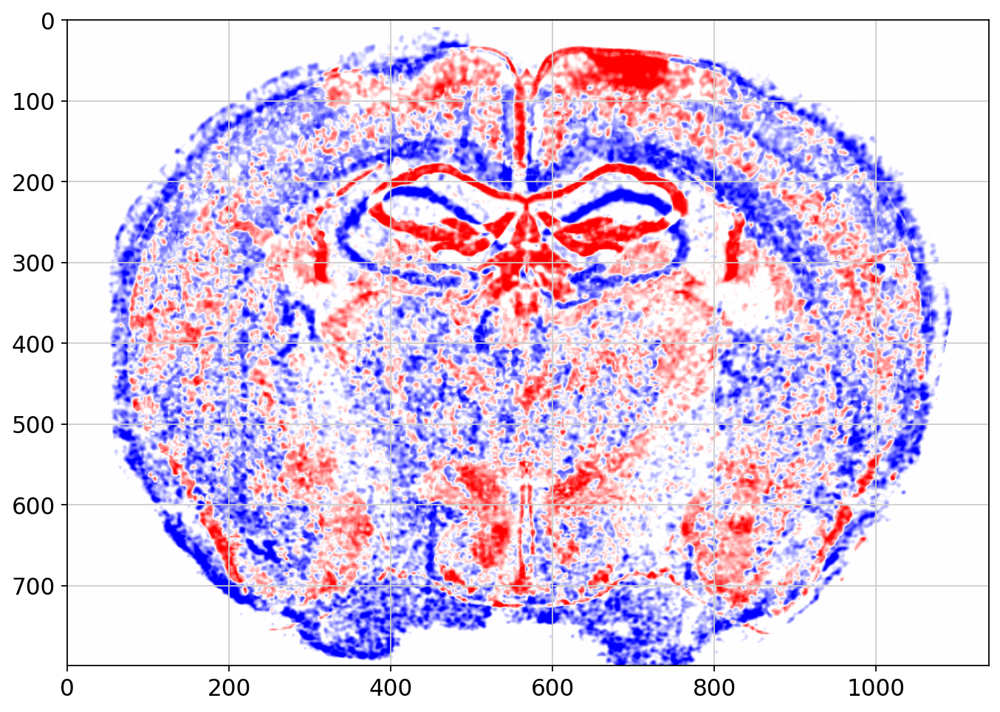

In [174]:
Display(normalized_template)
Display(normalized_reference)
Display(normalized_template.astype(float)-normalized_reference.astype(float),cmap='bwr')
Display(transformed_img)
Display(normalized_template.astype(float)-transformed_img.astype(float),cmap='bwr')
Display(normalized_reference.astype(float)-transformed_img.astype(float),cmap='bwr')

In [81]:
remaining_idxes

array([], dtype=int64)

In [77]:
total_idxes = np.array(range(dist_mat.shape[0]))
used_idxes = []
start_idx = reference_idx
while len(used_idxes)!=total_idxes.shape[0]:
    if len(used_idxes)==0:
        idx = start_idx
    used_idxes.append(idx)
    remaining_idxes = total_idxes[np.isin(total_idxes,used_idxes)==False]
    dist_mat[idx,remaining_idxes]
    temp_idx = torch.argmin(dist_mat[idx,remaining_idxes])
    idx = remaining_idxes[temp_idx]


368

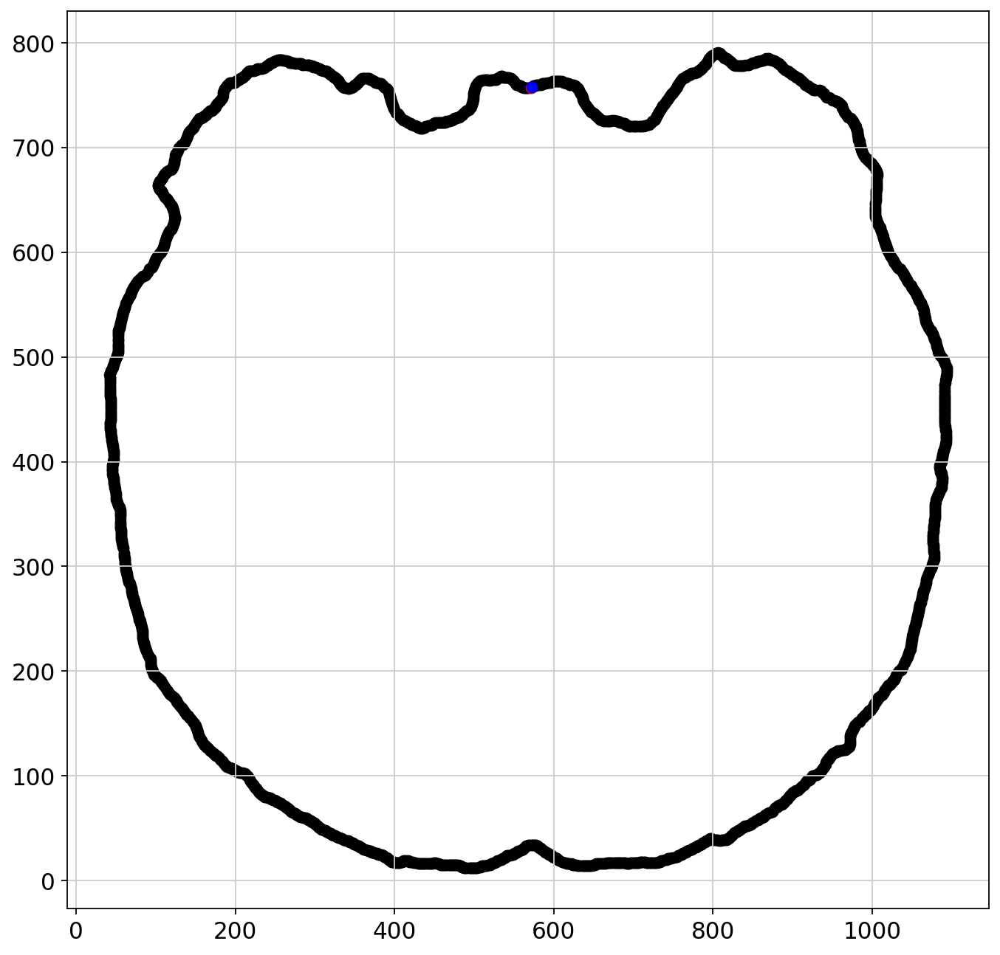

In [78]:
plt.figure(figsize=[10,10])
plt.scatter(reference_border_x,reference_border_y,c='k')
plt.scatter(reference_border_x[start_idx],reference_border_y[start_idx],c='r')
plt.scatter(reference_border_x[idx],reference_border_y[idx],c='b')
plt.show()
            

In [76]:
dist_mat[idx,remaining_idxes][torch.argmin(dist_mat[idx,remaining_idxes])]

tensor(1.4142, dtype=torch.float64)

In [71]:
remaining_idxes

array([   0,    1,    2, ..., 2679, 2680, 2681])

In [63]:
reference_xy_ordered = find_order(reference_xy)
template_xy_ordered = find_order(template_xy)

[942. 112.]
[array([942., 112.])]


IndexError: list index out of range

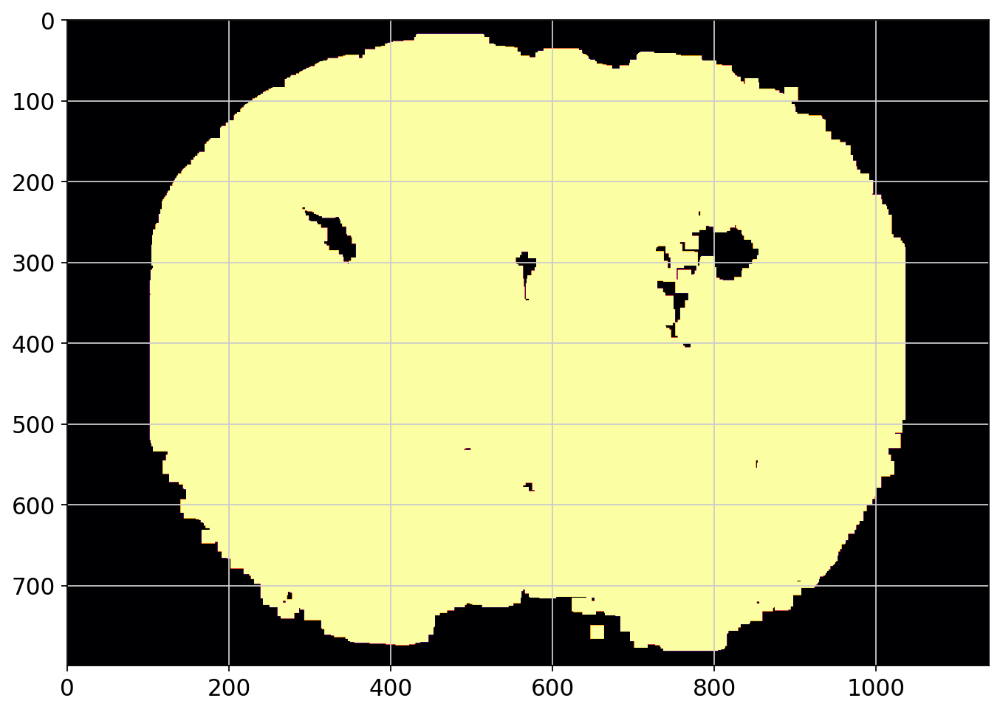

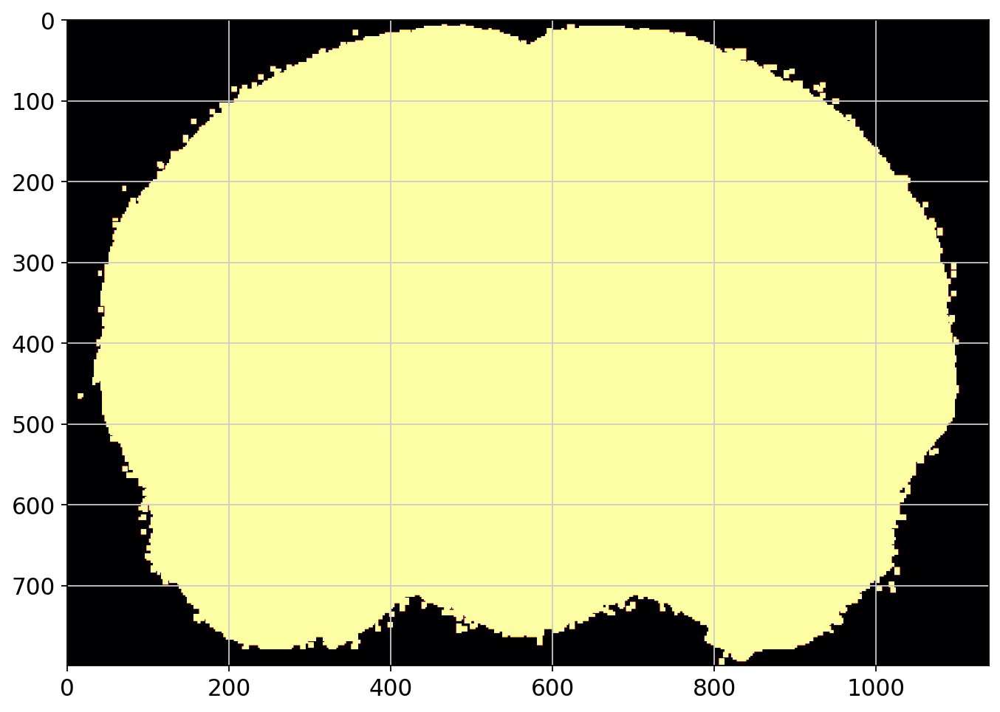

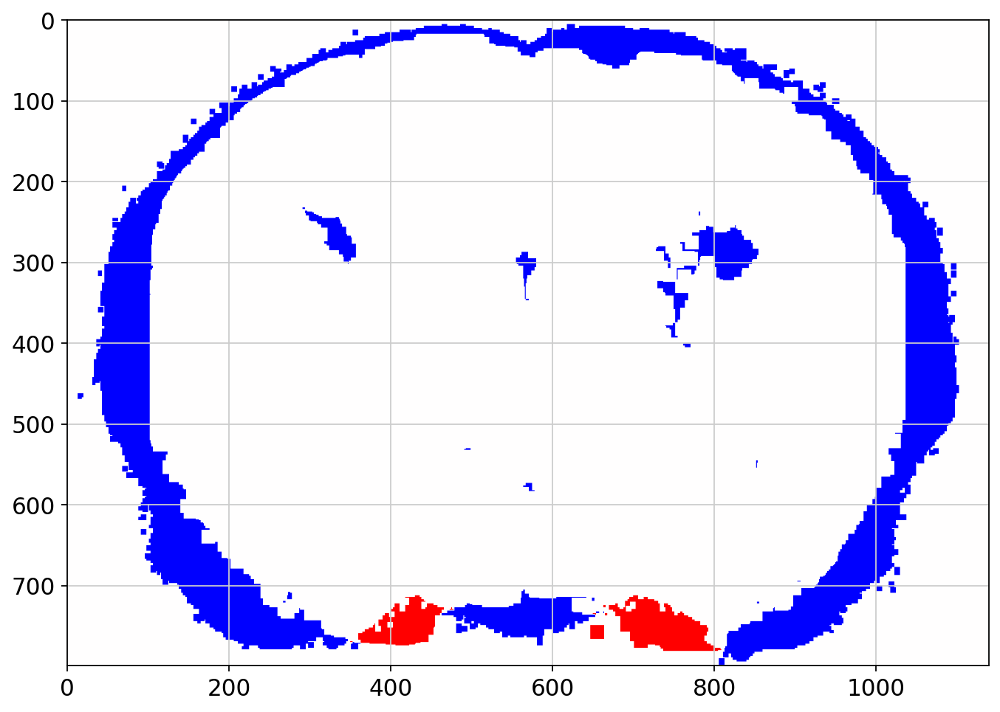

In [100]:
reference = ara_nissl[670,:,:].copy()
normalized_template = 1*(template>np.percentile(template.ravel(),1))
normalized_reference = 1*(reference>np.percentile(reference.ravel(),1))
Display(normalized_template)
Display(normalized_reference)
Display(normalized_template-normalized_reference,cmap='bwr')

In [15]:
reference.max()

22404.59

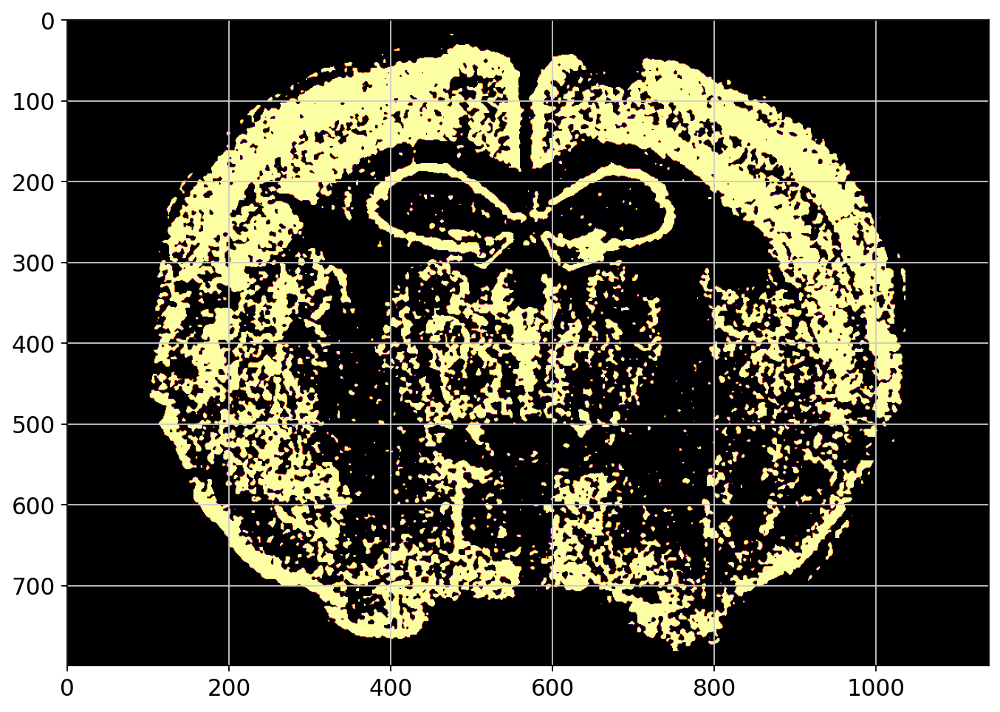

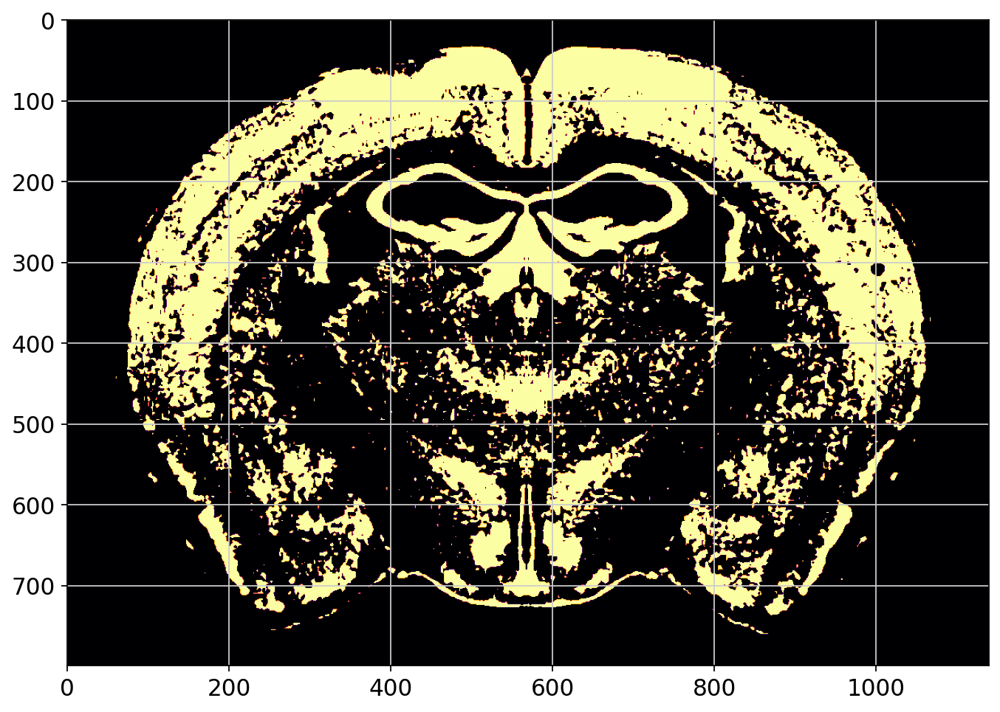

In [90]:
from  scipy.signal import correlate2d

reference = ara_nissl[660,:,:].copy()
normalized_template = template-np.percentile(template.ravel(),75)
normalized_template = normalized_template/(np.percentile(normalized_template.ravel(),75))
# normalized_template[normalized_template<0] = 0
normalized_template[normalized_template<1] = 0
normalized_template[normalized_template>1] = 1
# Display(normalized_template)
normalized_reference = reference-np.percentile(reference.ravel(),75)
normalized_reference = normalized_reference/(np.percentile(normalized_reference.ravel(),75))
# normalized_reference[normalized_reference<0] = 0
normalized_reference[normalized_reference<1] = 0
normalized_reference[normalized_reference>1] = 1
# normalized_reference = normalized_reference*255
# Display(normalized_reference)
# img = correlate2d(normalized_reference.astype('uint8'),normalized_template.astype('uint8'),mode='same')
# normalized_template = 255*normalized_template/normalized_template.max()
# normalized_reference = 255*normalized_reference/normalized_reference.max()
# normalized_reference[normalized_reference>1] = 255
Display(normalized_template)
Display(normalized_reference)
# Display(img)

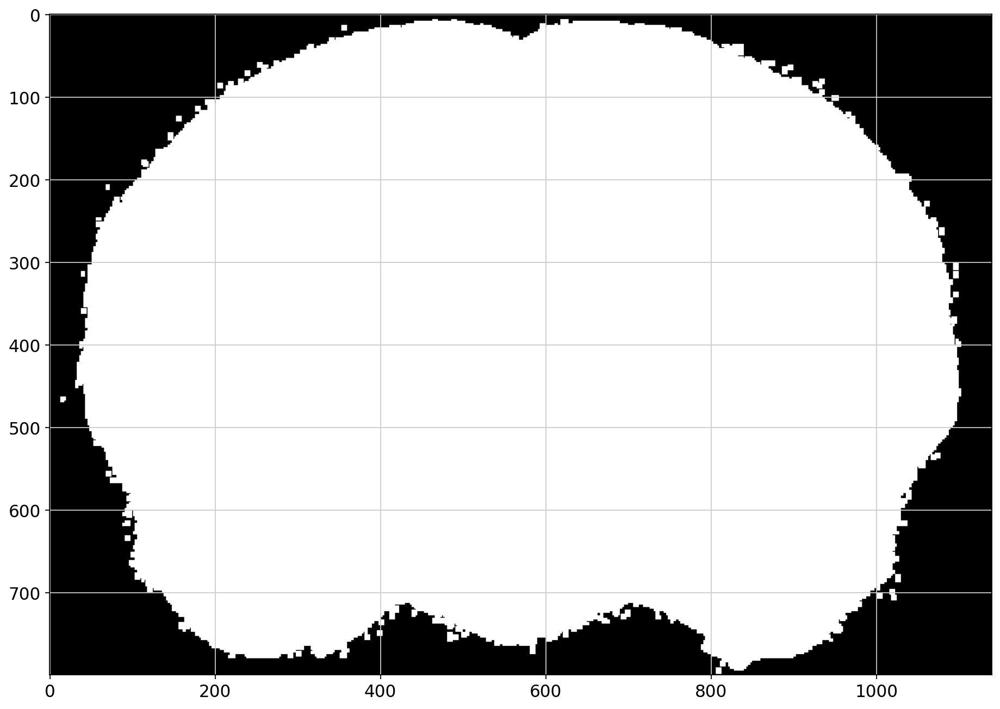

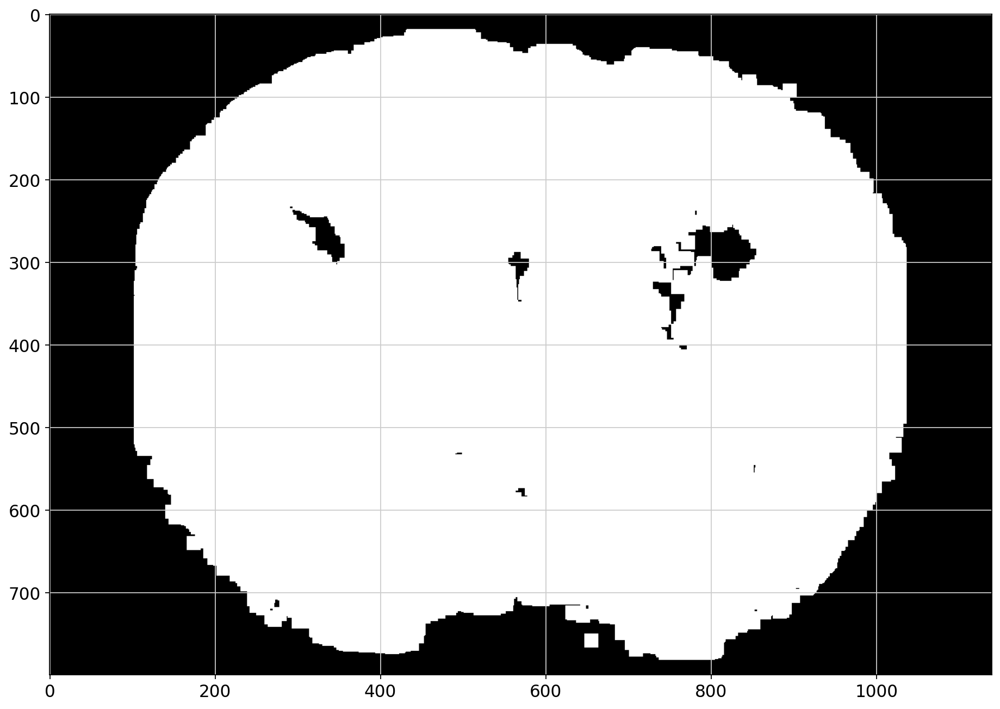

In [108]:
import cv2
import numpy as np
reference = ara_nissl[670,:,:].copy()
normalized_template = 255*(template>np.percentile(template.ravel(),1))
normalized_reference = 255*(reference>np.percentile(reference.ravel(),1))
# Open the image files.
img2_color = np.dstack([normalized_template,normalized_template,normalized_template]).astype('uint8')#cv2.imread("align.jpg")  # Image to be aligned.
img1_color = np.dstack([normalized_reference,normalized_reference,normalized_reference]).astype('uint8')#cv2.imread("ref.jpg")    # Reference image.
plt.imshow(img1_color)
plt.show()
plt.imshow(img2_color)
plt.show()
# Convert to grayscale.
img1 = cv2.cvtColor(img1_color, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2_color, cv2.COLOR_BGR2GRAY)
height, width = img2.shape
 
# Create ORB detector with 5000 features.
orb_detector = cv2.ORB_create(5000)
 
# Find keypoints and descriptors.
# The first arg is the image, second arg is the mask
#  (which is not required in this case).
kp1, d1 = orb_detector.detectAndCompute(img1, None)
kp2, d2 = orb_detector.detectAndCompute(img2, None)
 
# Match features between the two images.
# We create a Brute Force matcher with
# Hamming distance as measurement mode.
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)
 
# Match the two sets of descriptors.
matches = matcher.match(d1, d2)
 
# Sort matches on the basis of their Hamming distance.
list(matches).sort(key = lambda x: x.distance)
 
# Take the top 90 % matches forward.
matches = matches[:int(len(matches)*0.9)]
no_of_matches = len(matches)
 
# Define empty matrices of shape no_of_matches * 2.
p1 = np.zeros((no_of_matches, 2))
p2 = np.zeros((no_of_matches, 2))
 
for i in range(len(matches)):
    p1[i, :] = kp1[matches[i].queryIdx].pt
    p2[i, :] = kp2[matches[i].trainIdx].pt
homography, mask = cv2.findHomography(p1, p2, cv2.RANSAC)
 
# Use this matrix to transform the
# colored image wrt the reference image.
transformed_img = cv2.warpPerspective(img1_color,
                    homography, (width, height))

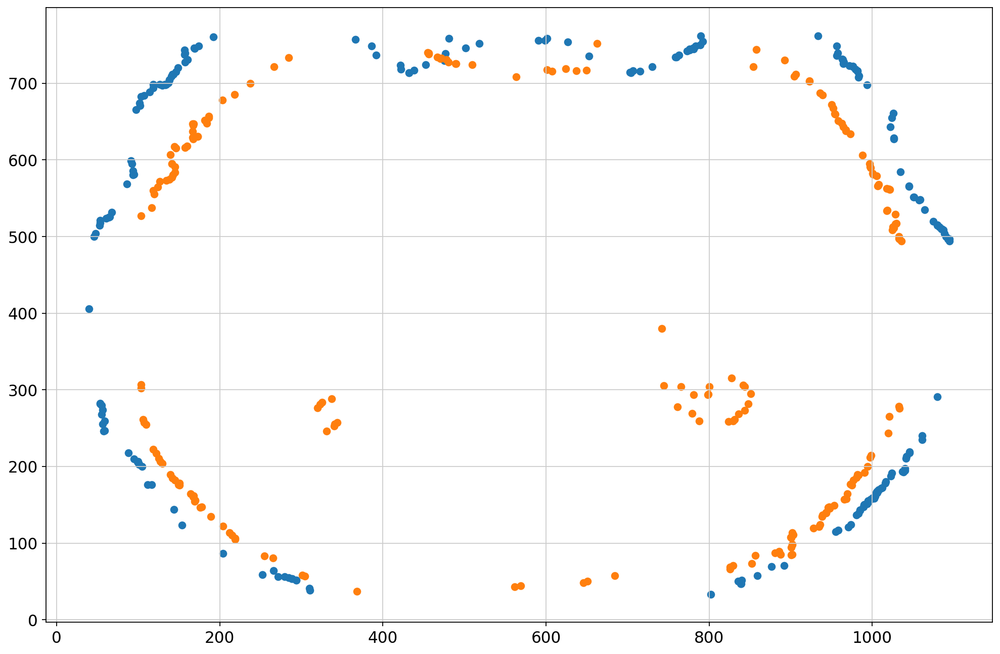

In [109]:
plt.scatter(p1[:,0],p1[:,1])
plt.scatter(p2[:,0],p2[:,1])
plt.show()

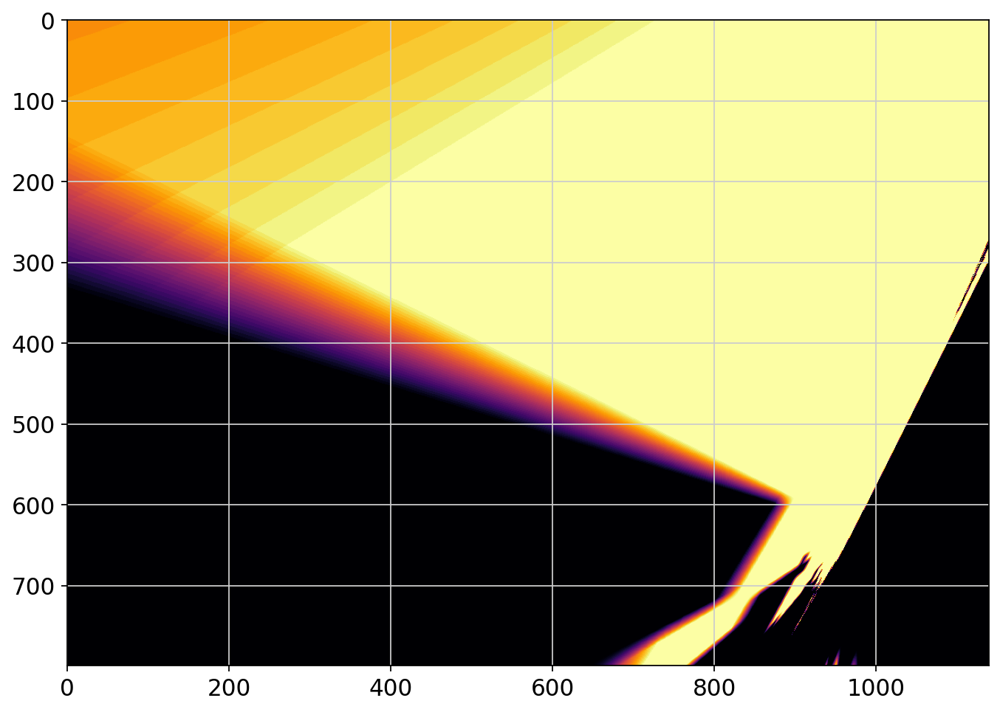

In [110]:
Display(transformed_img.max(2))

# Fine Non-Linear Registration XY